In [1]:
import warnings
warnings.filterwarnings('ignore')    

## Importing Basic Libraries

In [2]:
import pandas as pd 
import numpy as np 
import matplotlib.pyplot as plt 
import seaborn as sns 
from sklearn.preprocessing import LabelEncoder
import sweetviz as sv
import pandas_profiling as pp
import dtale

In [3]:
data = pd.read_csv("project-data.csv", delimiter=';')
data    

,category,age,sex,albumin,alkaline_phosphatase,alanine_aminotransferase,aspartate_aminotransferase,bilirubin,cholinesterase,cholesterol,creatinina,gamma_glutamyl_transferase,protein
0,no_disease,32,m,38.5,52.5,7.7,22.1,7.5,6.93,3.23,106.0,12.1,69
1,no_disease,32,m,38.5,70.3,18.0,24.7,3.9,11.17,4.80,74.0,15.6,76.5
2,no_disease,32,m,46.9,74.7,36.2,52.6,6.1,8.84,5.20,86.0,33.2,79.3
3,no_disease,32,m,43.2,52.0,30.6,22.6,18.9,7.33,4.74,80.0,33.8,75.7
4,no_disease,32,m,39.2,74.1,32.6,24.8,9.6,9.15,4.32,76.0,29.9,68.7
...,...,...,...,...,...,...,...,...,...,...,...,...,...
610,cirrhosis,62,f,32.0,416.6,5.9,110.3,50.0,5.57,6.30,55.7,650.9,68.5
611,cirrhosis,64,f,24.0,102.8,2.9,44.4,20.0,1.54,3.02,63.0,35.9,71.3
612,cirrhosis,64,f,29.0,87.3,3.5,99.0,48.0,1.66,3.63,66.7,64.2,82
613,cirrhosis,46,f,33.0,NaN,39.0,62.0,20.0,3.56,4.20,52.0,50.0,71


# AUTO EDA 

In [4]:
dtale.show(data)   

# EDA  

In [5]:
data.dtypes    

category                        object
age                              int64
sex                             object
albumin                        float64
alkaline_phosphatase           float64
alanine_aminotransferase       float64
aspartate_aminotransferase     float64
bilirubin                      float64
cholinesterase                 float64
cholesterol                    float64
creatinina                     float64
gamma_glutamyl_transferase     float64
protein                         object
dtype: object

In [6]:
data.info()  

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 615 entries, 0 to 614
Data columns (total 13 columns):
 #   Column                       Non-Null Count  Dtype  
---  ------                       --------------  -----  
 0   category                     615 non-null    object 
 1   age                          615 non-null    int64  
 2   sex                          615 non-null    object 
 3   albumin                      614 non-null    float64
 4   alkaline_phosphatase         597 non-null    float64
 5   alanine_aminotransferase     614 non-null    float64
 6   aspartate_aminotransferase   615 non-null    float64
 7   bilirubin                    615 non-null    float64
 8   cholinesterase               615 non-null    float64
 9   cholesterol                  605 non-null    float64
 10  creatinina                   615 non-null    float64
 11  gamma_glutamyl_transferase   615 non-null    float64
 12  protein                      615 non-null    object 
dtypes: float64(9), int64

In [7]:
data.columns   

Index(['category', 'age', 'sex', 'albumin', 'alkaline_phosphatase',
       'alanine_aminotransferase', 'aspartate_aminotransferase', 'bilirubin',
       'cholinesterase', 'cholesterol', 'creatinina',
       'gamma_glutamyl_transferase ', 'protein   '],
      dtype='object')

In [8]:
data.rename(columns = {'protein   ' : 'protein', 'gamma_glutamyl_transferase ' : 'gamma_glutamyl_transferase'}, inplace = True)   

In [9]:
data['protein'] = pd.to_numeric(data['protein'], errors='coerce')    

In [10]:
data.dtypes    

category                       object
age                             int64
sex                            object
albumin                       float64
alkaline_phosphatase          float64
alanine_aminotransferase      float64
aspartate_aminotransferase    float64
bilirubin                     float64
cholinesterase                float64
cholesterol                   float64
creatinina                    float64
gamma_glutamyl_transferase    float64
protein                       float64
dtype: object

In [11]:
data.duplicated().sum()    

0

In [12]:
data.describe()    

,age,albumin,alkaline_phosphatase,alanine_aminotransferase,aspartate_aminotransferase,bilirubin,cholinesterase,cholesterol,creatinina,gamma_glutamyl_transferase,protein
count,615.000000,614.000000,597.000000,614.000000,615.000000,615.000000,615.000000,605.000000,615.000000,615.000000,614.000000
mean,47.408130,41.620195,68.283920,28.450814,34.786341,11.396748,8.196634,5.368099,81.287805,39.533171,72.044137
std,10.055105,5.780629,26.028315,25.469689,33.090690,19.673150,2.205657,1.132728,49.756166,54.661071,5.402636
min,19.000000,14.900000,11.300000,0.900000,10.600000,0.800000,1.420000,1.430000,8.000000,4.500000,44.800000
25%,39.000000,38.800000,52.500000,16.400000,21.600000,5.300000,6.935000,4.610000,67.000000,15.700000,69.300000
50%,47.000000,41.950000,66.200000,23.000000,25.900000,7.300000,8.260000,5.300000,77.000000,23.300000,72.200000
75%,54.000000,45.200000,80.100000,33.075000,32.900000,11.200000,9.590000,6.060000,88.000000,40.200000,75.400000
max,77.000000,82.200000,416.600000,325.300000,324.000000,254.000000,16.410000,9.670000,1079.100000,650.900000,90.000000


In [13]:
data.isnull().any()    

category                      False
age                           False
sex                           False
albumin                        True
alkaline_phosphatase           True
alanine_aminotransferase       True
aspartate_aminotransferase    False
bilirubin                     False
cholinesterase                False
cholesterol                    True
creatinina                    False
gamma_glutamyl_transferase    False
protein                        True
dtype: bool

In [14]:
data.isna().sum()    

category                       0
age                            0
sex                            0
albumin                        1
alkaline_phosphatase          18
alanine_aminotransferase       1
aspartate_aminotransferase     0
bilirubin                      0
cholinesterase                 0
cholesterol                   10
creatinina                     0
gamma_glutamyl_transferase     0
protein                        1
dtype: int64

In [15]:
data[data.isnull().any(axis=1)]    

,category,age,sex,albumin,alkaline_phosphatase,alanine_aminotransferase,aspartate_aminotransferase,bilirubin,cholinesterase,cholesterol,creatinina,gamma_glutamyl_transferase,protein
121,no_disease,43,m,48.6,45.0,10.5,40.5,5.3,7.09,NaN,63.0,25.1,70.0
319,no_disease,32,f,47.4,52.5,19.1,17.1,4.6,10.19,NaN,63.0,23.0,72.2
329,no_disease,33,f,42.4,137.2,14.2,13.1,3.4,8.23,NaN,48.0,25.7,74.4
413,no_disease,46,f,42.9,55.1,15.2,29.8,3.6,8.37,NaN,61.0,29.0,71.9
424,no_disease,48,f,45.6,107.2,24.4,39.0,13.8,9.77,NaN,88.0,38.0,75.1
433,no_disease,48,f,46.8,93.3,10.0,23.2,4.3,12.41,NaN,52.0,23.9,72.4
498,no_disease,57,f,48.4,94.4,2.5,39.6,2.3,8.84,NaN,82.0,6.4,76.8
540,hepatitis,38,m,45.0,56.3,NaN,33.1,7.0,9.58,6.0,77.9,18.9,63.0
541,hepatitis,19,m,41.0,NaN,87.0,67.0,12.0,7.55,3.9,62.0,65.0,75.0
545,hepatitis,29,m,49.0,NaN,53.0,39.0,15.0,8.79,3.6,79.0,37.0,90.0


In [16]:
data.mean()    

age                           47.408130
albumin                       41.620195
alkaline_phosphatase          68.283920
alanine_aminotransferase      28.450814
aspartate_aminotransferase    34.786341
bilirubin                     11.396748
cholinesterase                 8.196634
cholesterol                    5.368099
creatinina                    81.287805
gamma_glutamyl_transferase    39.533171
protein                       72.044137
dtype: float64

In [17]:
data.var()    

age                            101.105146
albumin                         33.415676
alkaline_phosphatase           677.473197
alanine_aminotransferase       648.705048
aspartate_aminotransferase    1094.993787
bilirubin                      387.032823
cholinesterase                   4.864924
cholesterol                      1.283074
creatinina                    2475.676056
gamma_glutamyl_transferase    2987.832709
protein                         29.188473
dtype: float64

In [18]:
data.median()    

age                           47.00
albumin                       41.95
alkaline_phosphatase          66.20
alanine_aminotransferase      23.00
aspartate_aminotransferase    25.90
bilirubin                      7.30
cholinesterase                 8.26
cholesterol                    5.30
creatinina                    77.00
gamma_glutamyl_transferase    23.30
protein                       72.20
dtype: float64

In [19]:
data.skew()   

age                            0.267134
albumin                       -0.176768
alkaline_phosphatase           4.654921
alanine_aminotransferase       5.506114
aspartate_aminotransferase     4.940327
bilirubin                      8.385437
cholinesterase                -0.110233
cholesterol                    0.375828
creatinina                    15.169291
gamma_glutamyl_transferase     5.632734
protein                       -0.963687
dtype: float64

In [20]:
data.kurt()   

age                            -0.386473
albumin                         5.983301
alkaline_phosphatase           54.972905
alanine_aminotransferase       47.129261
aspartate_aminotransferase     30.836641
bilirubin                      83.186732
cholinesterase                  1.314730
cholesterol                     0.694023
creatinina                    280.100237
gamma_glutamyl_transferase     43.712579
protein                         3.544529
dtype: float64

In [21]:
mean=data.mean()
print(mean)    

age                           47.408130
albumin                       41.620195
alkaline_phosphatase          68.283920
alanine_aminotransferase      28.450814
aspartate_aminotransferase    34.786341
bilirubin                     11.396748
cholinesterase                 8.196634
cholesterol                    5.368099
creatinina                    81.287805
gamma_glutamyl_transferase    39.533171
protein                       72.044137
dtype: float64


In [22]:
data=data.fillna(mean)     

In [23]:
data.isna().sum()   

category                      0
age                           0
sex                           0
albumin                       0
alkaline_phosphatase          0
alanine_aminotransferase      0
aspartate_aminotransferase    0
bilirubin                     0
cholinesterase                0
cholesterol                   0
creatinina                    0
gamma_glutamyl_transferase    0
protein                       0
dtype: int64

In [24]:
pd.set_option("Display.max.rows",None)    

In [25]:
data1=data.copy()   

In [26]:
mean1=data1.mean()
print(mean1)    

age                           47.408130
albumin                       41.620195
alkaline_phosphatase          68.283920
alanine_aminotransferase      28.450814
aspartate_aminotransferase    34.786341
bilirubin                     11.396748
cholinesterase                 8.196634
cholesterol                    5.368099
creatinina                    81.287805
gamma_glutamyl_transferase    39.533171
protein                       72.044137
dtype: float64


In [27]:
data1.corr()   

,age,albumin,alkaline_phosphatase,alanine_aminotransferase,aspartate_aminotransferase,bilirubin,cholinesterase,cholesterol,creatinina,gamma_glutamyl_transferase,protein
age,1.000000,-0.197005,0.168473,-0.006017,0.088666,0.032492,-0.075093,0.123978,-0.022296,0.153087,-0.153665
albumin,-0.197005,1.000000,-0.138858,0.001606,-0.193397,-0.221650,0.375848,0.204803,-0.001573,-0.155555,0.550033
alkaline_phosphatase,0.168473,-0.138858,1.000000,0.172461,0.062202,0.048600,0.032971,0.121914,0.149554,0.442262,-0.053633
alanine_aminotransferase,-0.006017,0.001606,0.172461,1.000000,0.273325,-0.038468,0.146953,0.068023,-0.043025,0.248086,0.094373
aspartate_aminotransferase,0.088666,-0.193397,0.062202,0.273325,1.000000,0.312231,-0.208536,-0.207507,-0.021387,0.491263,0.039888
bilirubin,0.032492,-0.221650,0.048600,-0.038468,0.312231,1.000000,-0.333172,-0.156261,0.031224,0.217024,-0.041309
cholinesterase,-0.075093,0.375848,0.032971,0.146953,-0.208536,-0.333172,1.000000,0.420163,-0.011157,-0.110345,0.293184
cholesterol,0.123978,0.204803,0.121914,0.068023,-0.207507,-0.156261,0.420163,1.000000,-0.047667,-0.006828,0.206546
creatinina,-0.022296,-0.001573,0.149554,-0.043025,-0.021387,0.031224,-0.011157,-0.047667,1.000000,0.121003,-0.031693
gamma_glutamyl_transferase,0.153087,-0.155555,0.442262,0.248086,0.491263,0.217024,-0.110345,-0.006828,0.121003,1.000000,-0.011735


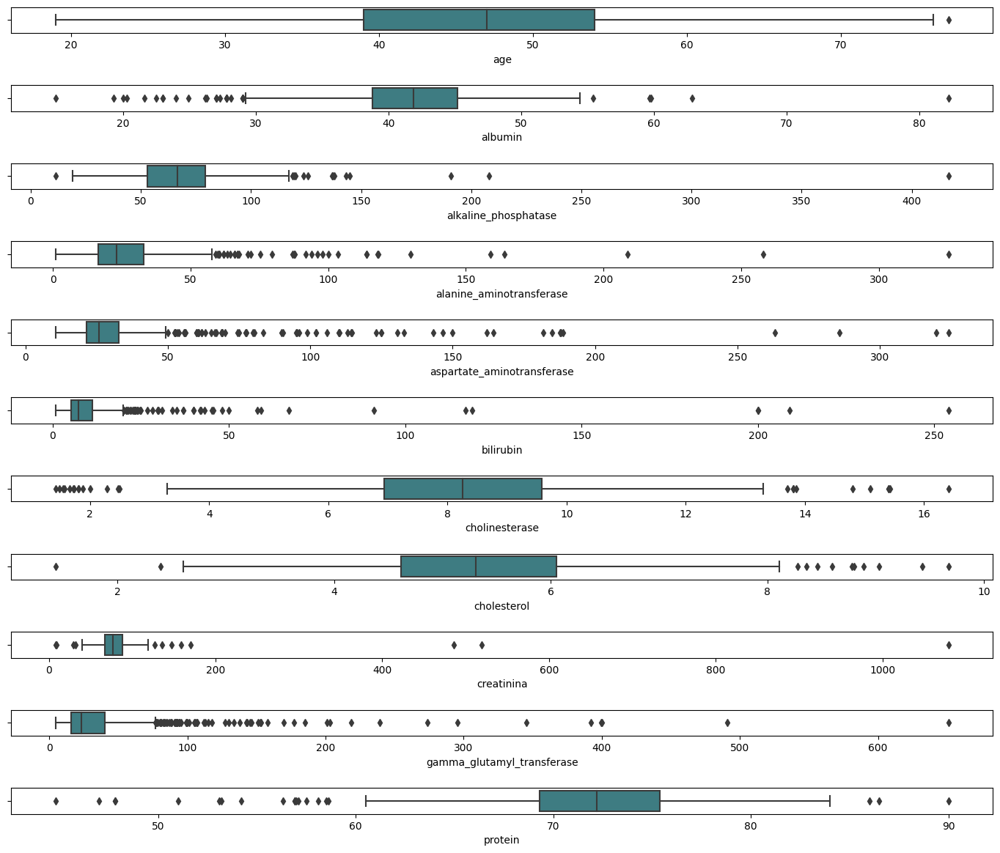

In [28]:
fig, axes=plt.subplots(11,1,figsize=(14,12),sharex=False,sharey=False)
sns.boxplot(x='age',data=data1,palette='crest',ax=axes[0])
sns.boxplot(x='albumin',data=data1,palette='crest',ax=axes[1])
sns.boxplot(x='alkaline_phosphatase',data=data1,palette='crest',ax=axes[2])
sns.boxplot(x='alanine_aminotransferase',data=data1,palette='crest',ax=axes[3])
sns.boxplot(x='aspartate_aminotransferase',data=data1,palette='crest',ax=axes[4])
sns.boxplot(x='bilirubin',data=data1,palette='crest',ax=axes[5])
sns.boxplot(x='cholinesterase',data=data1,palette='crest',ax=axes[6])
sns.boxplot(x='cholesterol',data=data1,palette='crest',ax=axes[7])
sns.boxplot(x='creatinina',data=data1,palette='crest',ax=axes[8])
sns.boxplot(x='gamma_glutamyl_transferase',data=data1,palette='crest',ax=axes[9])
sns.boxplot(x='protein',data=data1,palette='crest',ax=axes[10])
plt.tight_layout(pad=2.0)    

In [30]:
data1.describe()     

,age,albumin,alkaline_phosphatase,alanine_aminotransferase,aspartate_aminotransferase,bilirubin,cholinesterase,cholesterol,creatinina,gamma_glutamyl_transferase,protein
count,615.000000,615.000000,615.000000,615.000000,615.000000,615.000000,615.000000,615.000000,615.000000,615.000000,615.000000
mean,47.408130,41.620195,68.283920,28.450814,34.786341,11.396748,8.196634,5.368099,81.287805,39.533171,72.044137
std,10.055105,5.775920,25.643955,25.448940,33.090690,19.673150,2.205657,1.123466,49.756166,54.661071,5.398234
min,19.000000,14.900000,11.300000,0.900000,10.600000,0.800000,1.420000,1.430000,8.000000,4.500000,44.800000
25%,39.000000,38.800000,52.950000,16.400000,21.600000,5.300000,6.935000,4.620000,67.000000,15.700000,69.300000
50%,47.000000,41.900000,66.700000,23.000000,25.900000,7.300000,8.260000,5.310000,77.000000,23.300000,72.200000
75%,54.000000,45.200000,79.300000,33.050000,32.900000,11.200000,9.590000,6.055000,88.000000,40.200000,75.400000
max,77.000000,82.200000,416.600000,325.300000,324.000000,254.000000,16.410000,9.670000,1079.100000,650.900000,90.000000


# Graphical Representation  

In [34]:
obj_colum = data1.select_dtypes(include='object').columns.tolist() 
obj_colum     

['category', 'sex']

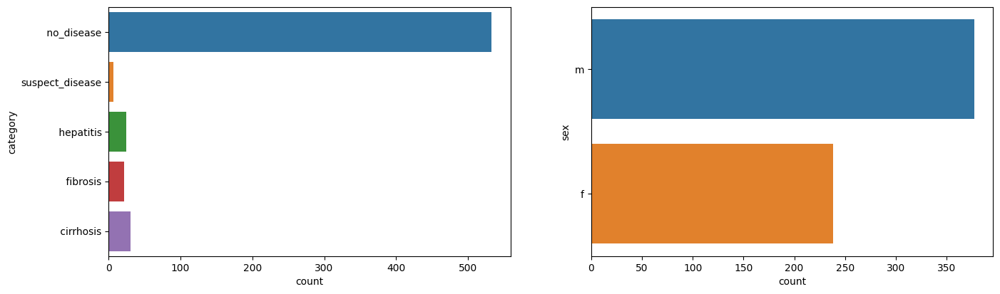

In [35]:
plt.figure(figsize=(16,10))
for i,col in enumerate(obj_colum,1):
    plt.subplot(2,2,i)
    sns.countplot(data=data1,y=col)
    plt.subplot(2,2,i)                

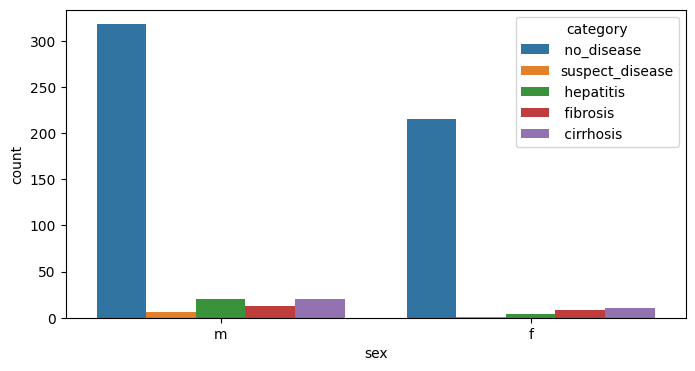

In [36]:
#Count Plot for Sex column WRT Category 
plt.figure(figsize=(8,4))
sns.countplot(x='sex', hue='category', data=data1); 

<AxesSubplot: >

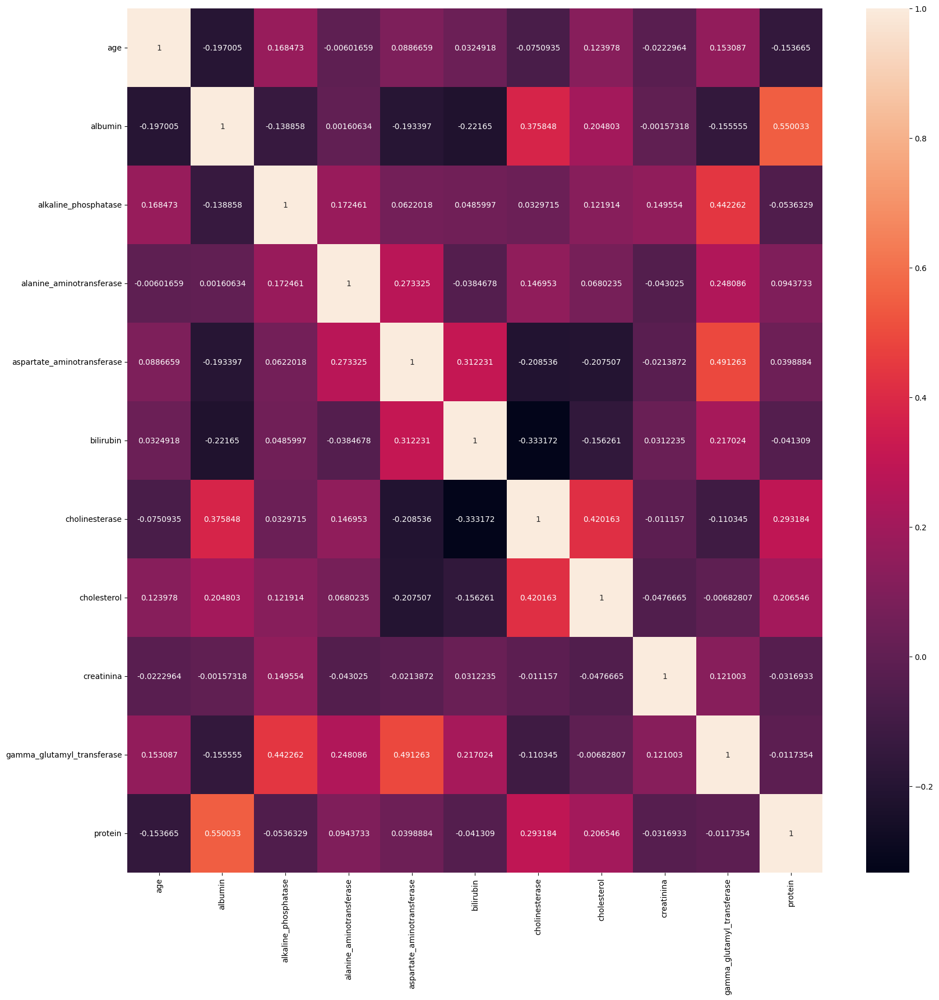

In [37]:
plt.figure(figsize=(20,20))
sns.heatmap(data1.corr(),annot=True,fmt="g") 

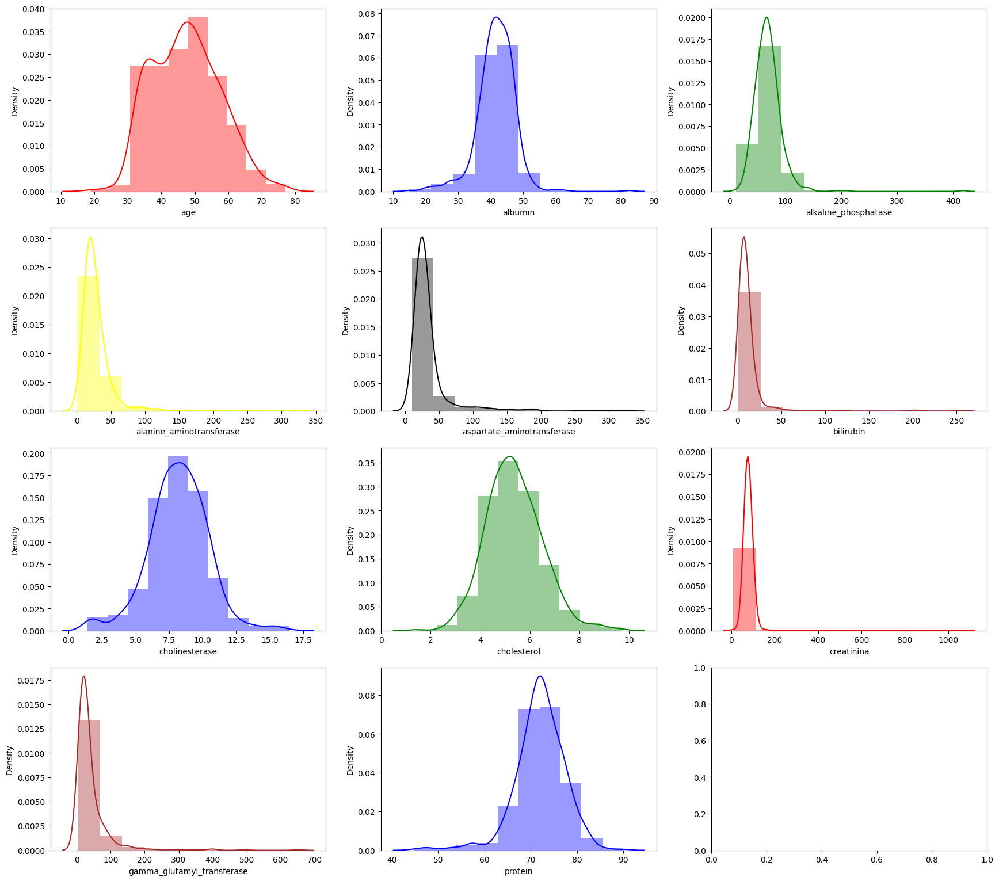

In [39]:
import seaborn as sns

plt.figure(figsize=(21,19)) 

plt.subplot(4,3,1)
sns.distplot(data1['age'],bins=10,  kde = True, color =  'red' )      
plt.subplot(4,3,2)
sns.distplot(data1['albumin'],bins=10,  kde = True, color =  'blue' )      
plt.subplot(4,3,3)
sns.distplot(data1['alkaline_phosphatase'],bins=10,  kde = True, color =  'green' )      
plt.subplot(4,3,4)
sns.distplot(data1['alanine_aminotransferase'],bins=10,  kde = True, color =  'yellow' )      
plt.subplot(4,3,5) 
sns.distplot(data1['aspartate_aminotransferase'],bins=10,  kde = True, color =  'black' )      
plt.subplot(4,3,6)
sns.distplot(data1['bilirubin'],bins=10,  kde = True, color =  'brown' )      
plt.subplot(4,3,7)
sns.distplot(data1['cholinesterase'],bins=10,  kde = True, color =  'blue' )      
plt.subplot(4,3,8)
sns.distplot(data1['cholesterol'],bins=10,  kde = True, color =  'green' )      
plt.subplot(4,3,9)
sns.distplot(data1['creatinina'],bins=10,  kde = True, color =  'red' )      
plt.subplot(4,3,10)
sns.distplot(data1['gamma_glutamyl_transferase'],bins=10,  kde = True, color =  'brown' )      
plt.subplot(4,3,11)
sns.distplot(data1['protein'],bins=10,  kde = True, color =  'blue' )      
plt.subplot(4,3,12)

plt.show()         

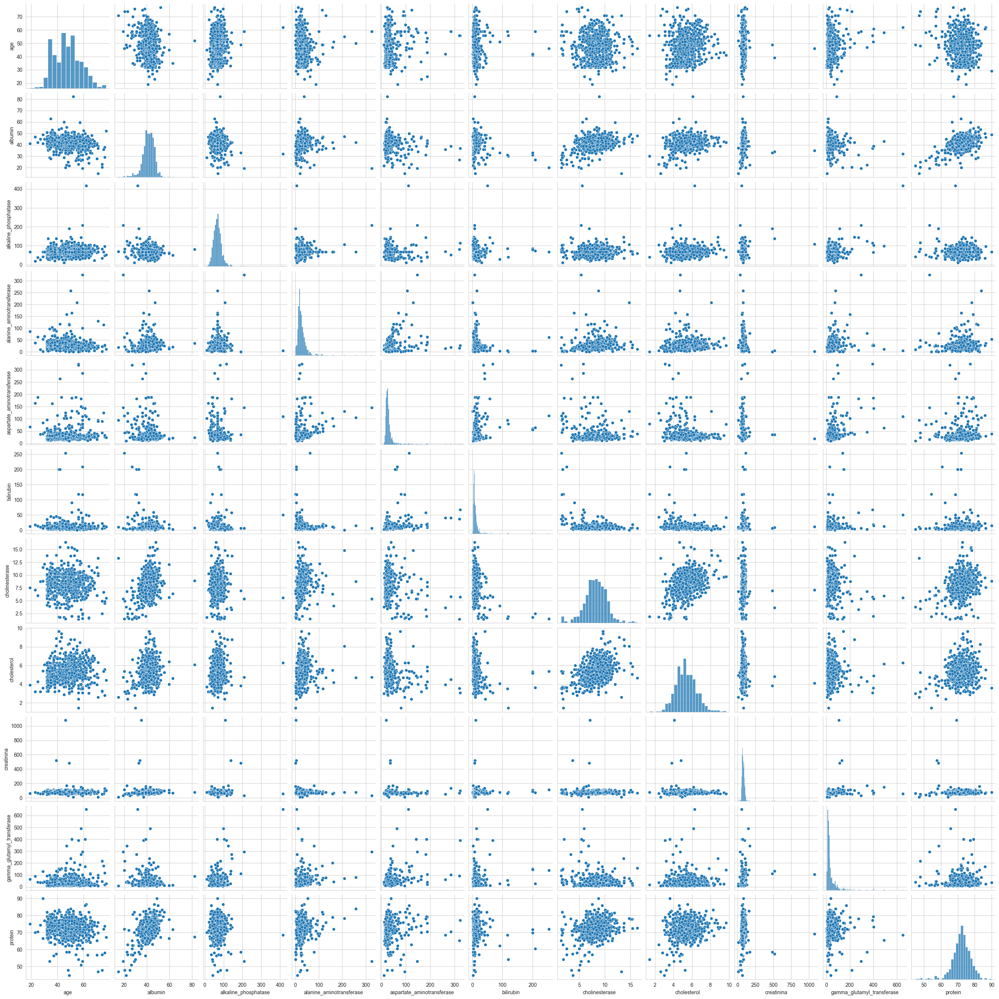

In [40]:
sns.set_style(style='whitegrid')
sns.pairplot(data1)     

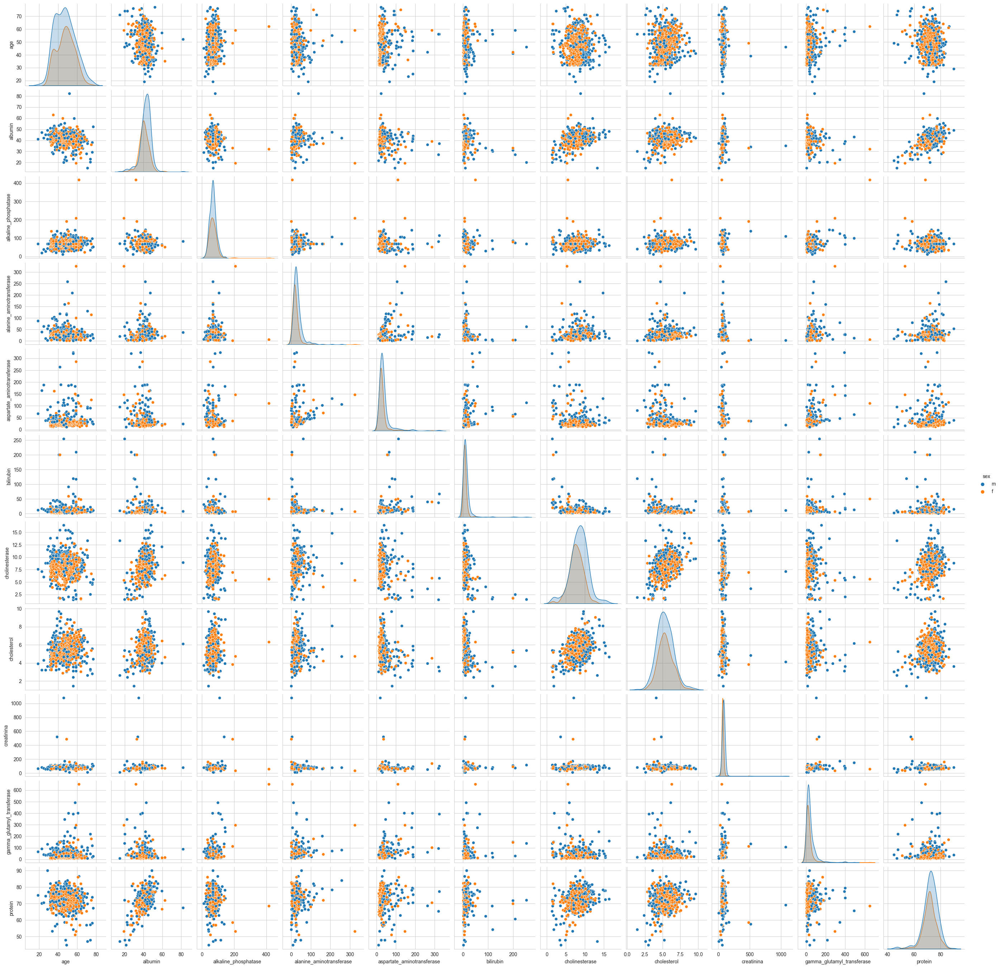

In [41]:
#Pair Plot WRT Sex
sns.pairplot(data1,hue='sex')
plt.show() 

Blue - Male,
Orange - Female

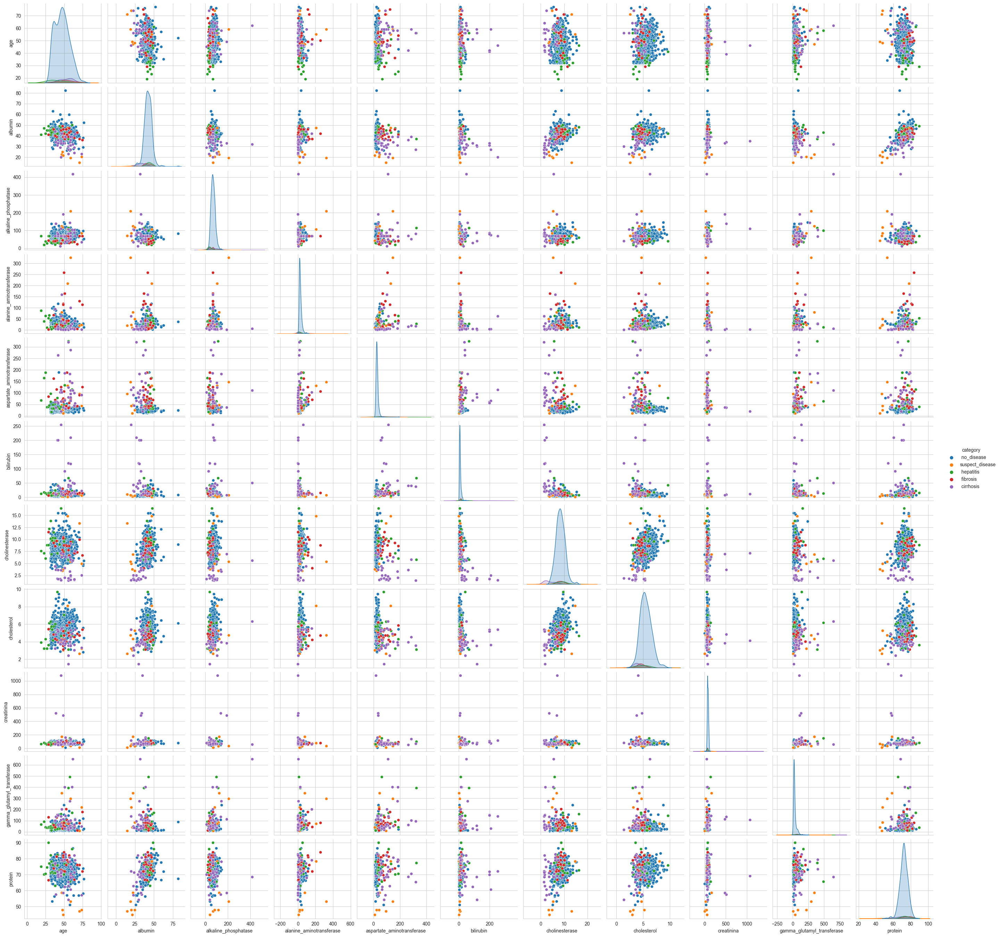

In [42]:
#Pair Plot WRT Category
sns.pairplot(data1,hue='category')
plt.show() 

Blue - no_disease,
Orange - suspect_disease,
Gereen - hepatitis,
Red - fibrosis,
Purple - cirrhosis

In [43]:
data1.describe()     

,age,albumin,alkaline_phosphatase,alanine_aminotransferase,aspartate_aminotransferase,bilirubin,cholinesterase,cholesterol,creatinina,gamma_glutamyl_transferase,protein
count,615.000000,615.000000,615.000000,615.000000,615.000000,615.000000,615.000000,615.000000,615.000000,615.000000,615.000000
mean,47.408130,41.620195,68.283920,28.450814,34.786341,11.396748,8.196634,5.368099,81.287805,39.533171,72.044137
std,10.055105,5.775920,25.643955,25.448940,33.090690,19.673150,2.205657,1.123466,49.756166,54.661071,5.398234
min,19.000000,14.900000,11.300000,0.900000,10.600000,0.800000,1.420000,1.430000,8.000000,4.500000,44.800000
25%,39.000000,38.800000,52.950000,16.400000,21.600000,5.300000,6.935000,4.620000,67.000000,15.700000,69.300000
50%,47.000000,41.900000,66.700000,23.000000,25.900000,7.300000,8.260000,5.310000,77.000000,23.300000,72.200000
75%,54.000000,45.200000,79.300000,33.050000,32.900000,11.200000,9.590000,6.055000,88.000000,40.200000,75.400000
max,77.000000,82.200000,416.600000,325.300000,324.000000,254.000000,16.410000,9.670000,1079.100000,650.900000,90.000000


# Handling Outliers  

## Age

In [44]:
Q1_age = 39.00
Q3_age = 54.00
IQR_age = Q3_age - Q1_age 
IQR_age   

15.0

In [45]:
Q3_age+1.5*IQR_age #UE    

76.5

In [46]:
Q1_age-1.5*IQR_age #LE    

16.5

In [47]:
upper_age = np.where(data1['age'] > (Q3_age+1.5*IQR_age)) 
upper_age    

(array([317], dtype=int64),)

In [48]:
lower_age = np.where(data1['age'] < (Q1_age-1.5*IQR_age)) 
lower_age    

(array([], dtype=int64),)

In [49]:
probable_outliers_age= [317 ]

def outliers_to_nan(data1,age, probable_outliers_age):
    for i in probable_outliers_age:
        data1.at[i,age] = None
    return data1 

data1 = outliers_to_nan(data1, 'age', probable_outliers_age)   

In [50]:
M1 = 47.408130    

In [51]:
data1['age']=data1['age'].fillna(M1)        

<AxesSubplot: >

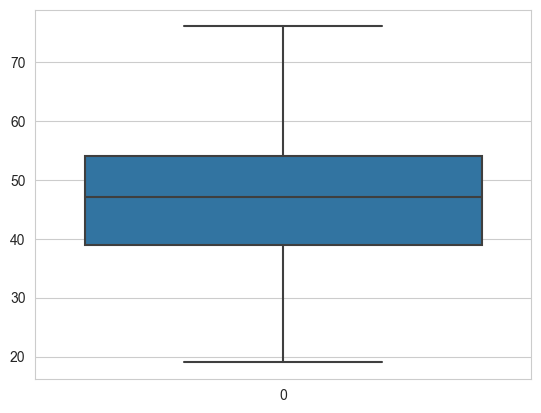

In [52]:
sns.boxplot(data1['age'])      

## Albumin 

In [53]:
Q1_albumin = 38.80
Q3_albumin = 45.20
IQR_albumin = Q3_albumin - Q1_albumin 
IQR_albumin    

6.400000000000006

In [54]:
Q3_albumin+1.5*IQR_albumin #UE    

54.80000000000001

In [55]:
Q1_albumin-1.5*IQR_albumin #LE    

29.19999999999999

In [56]:
upper_albumin = np.where(data1['albumin'] > (Q3_albumin+1.5*IQR_albumin)) 
upper_albumin    

(array([173, 216, 259, 346, 405], dtype=int64),)

In [57]:
lower_albumin = np.where(data1['albumin'] < (Q1_albumin-1.5*IQR_albumin)) 
lower_albumin    

(array([ 27,  42, 248, 312, 483, 502, 509, 527, 533, 534, 535, 537, 538,
        539, 589, 590, 595, 596, 600, 604, 611, 612], dtype=int64),)

In [58]:
probable_outliers_albumin = [173, 216, 259, 346, 405, 27,  42, 248, 312, 483, 502, 509, 527, 533, 534, 535, 537, 538,
        539, 589, 590, 595, 596, 600, 604, 611, 612]

def outliers_to_nan(data1,albumin, probable_outliers_albumin):
    for i in probable_outliers_albumin:
        data1.at[i, albumin] = None
    return data1 

data1 = outliers_to_nan(data1, 'albumin', probable_outliers_albumin)

In [59]:
M2 = 41.620195

In [60]:
data1['albumin']=data1['albumin'].fillna(M2)       

<AxesSubplot: >

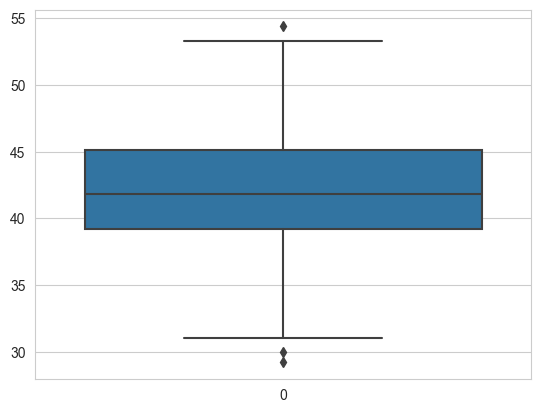

In [61]:
sns.boxplot(data1['albumin'])       

## Alkaline phophatase  

In [62]:
Q1_alkaline_phosphatase = 52.95
Q3_alkaline_phosphatase = 79.30
IQR_alkaline_phosphatase = Q3_alkaline_phosphatase - Q1_alkaline_phosphatase 
IQR_alkaline_phosphatase     

26.349999999999994

In [63]:
Q3_alkaline_phosphatase+1.5*IQR_alkaline_phosphatase #UE     

118.82499999999999

In [64]:
Q1_alkaline_phosphatase-1.5*IQR_alkaline_phosphatase #LE     

13.425000000000011

In [65]:
upper_alkaline_phosphatase = np.where(data1['alkaline_phosphatase'] > (Q3_alkaline_phosphatase+1.5*IQR_alkaline_phosphatase)) 
upper_alkaline_phosphatase      

(array([ 66, 118, 205, 231, 329, 438, 458, 533, 539, 586, 598, 606, 610],
       dtype=int64),)

In [66]:
lower_alkaline_phosphatase = np.where(data1['alkaline_phosphatase'] < (Q1_alkaline_phosphatase-1.5*IQR_alkaline_phosphatase)) 
lower_alkaline_phosphatase      

(array([589], dtype=int64),)

In [67]:
probable_outliers_alkaline = [66, 118, 205, 231, 329, 438, 458, 533, 539, 586, 598, 606, 610,589]

def outliers_to_nan(data1,alkaline_phosphatase, probable_outliers_alkaline):
    for i in probable_outliers_alkaline:
        data1.at[i,alkaline_phosphatase] = None
    return data1 

data1 = outliers_to_nan(data1, 'alkaline_phosphatase', probable_outliers_alkaline)      

In [68]:
M3 =  68.283920    

In [69]:
data1['alkaline_phosphatase']=data1['alkaline_phosphatase'].fillna(M3)         

<AxesSubplot: >

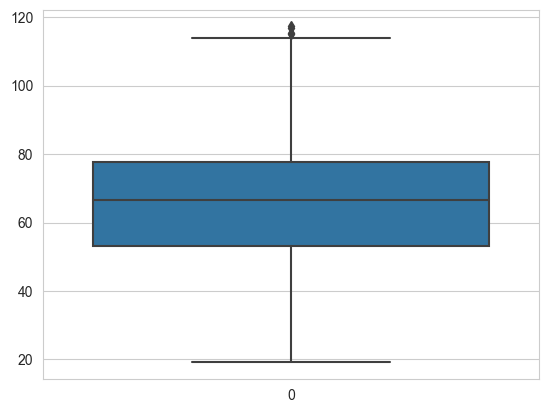

In [70]:
sns.boxplot(data1['alkaline_phosphatase'])       

## Alanine_aminotransferase  

In [71]:
Q1_alanine_aminotransferase = 16.40
Q3_alanine_aminotransferase = 33.05
IQR_alanine_aminotransferase = Q3_alanine_aminotransferase - Q1_alanine_aminotransferase 
IQR_alanine_aminotransferase      

16.65

In [72]:
Q3_alanine_aminotransferase+1.5*IQR_alanine_aminotransferase #UE     

58.02499999999999

In [73]:
Q1_alanine_aminotransferase-1.5*IQR_alanine_aminotransferase #LE     

-8.575

In [74]:
upper_alanine_aminotransferase = np.where(data1['alanine_aminotransferase'] > (Q3_alanine_aminotransferase+1.5*IQR_alanine_aminotransferase)) 
upper_alanine_aminotransferase      

(array([ 23,  45,  64,  65,  71,  78,  84,  94, 114, 140, 144, 156, 182,
        194, 227, 260, 431, 452, 462, 533, 536, 539, 541, 543, 546, 568,
        569, 570, 576, 577, 582, 584, 585, 590, 592, 614], dtype=int64),)

In [75]:
lower_alanine_aminotransferase = np.where(data1['alanine_aminotransferase'] < (Q1_alanine_aminotransferase-1.5*IQR_alanine_aminotransferase)) 
lower_alanine_aminotransferase    

(array([], dtype=int64),)

In [76]:
probable_outliers_alanine = [23,  45,  64,  65,  71,  78,  84,  94, 114, 140, 144, 156, 182,
        194, 227, 260, 431, 452, 462, 533, 536, 539, 541, 543, 546, 568,
        569, 570, 576, 577, 582, 584, 585, 590, 592, 614]

def outliers_to_nan(data1,alanine_aminotransferase, probable_outliers_alanine):
    for i in probable_outliers_alanine:
        data1.at[i,alanine_aminotransferase] = None
    return data1 

data1 = outliers_to_nan(data1, 'alanine_aminotransferase', probable_outliers_alanine)  

In [77]:
M4 = 28.450814

In [78]:
data1['alanine_aminotransferase']=data1['alanine_aminotransferase'].fillna(M4)   

<AxesSubplot: >

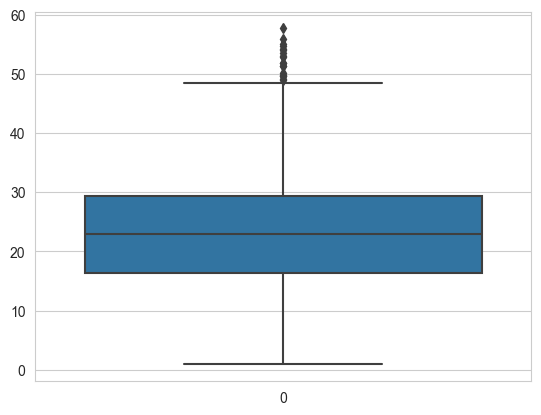

In [79]:
sns.boxplot(data1['alanine_aminotransferase'])         

## Aspartate_aminotransferase  

In [80]:
Q1_aspartate_aminotransferase = 21.60
Q3_aspartate_aminotransferase = 32.90
IQR_aspartate_aminotransferase = Q3_aspartate_aminotransferase - Q1_aspartate_aminotransferase 
IQR_aspartate_aminotransferase     

11.299999999999997

In [81]:
Q3_aspartate_aminotransferase+1.5*IQR_aspartate_aminotransferase #UE     

49.849999999999994

In [82]:
Q1_aspartate_aminotransferase-1.5*IQR_aspartate_aminotransferase #LE     

4.650000000000006

In [83]:
upper_aspartate_aminotransferase = np.where(data1['aspartate_aminotransferase'] > (Q3_aspartate_aminotransferase+1.5*IQR_aspartate_aminotransferase)) 
upper_aspartate_aminotransferase     

(array([  2,  34,  84, 108, 126, 194, 236, 324, 452, 509, 536, 537, 539,
        541, 542, 543, 547, 548, 552, 553, 557, 558, 559, 563, 564, 565,
        566, 567, 568, 569, 570, 572, 573, 574, 576, 577, 578, 582, 584,
        585, 587, 588, 589, 590, 592, 593, 594, 595, 596, 597, 598, 599,
        600, 601, 602, 603, 604, 605, 608, 609, 610, 612, 613, 614],
       dtype=int64),)

In [84]:
lower_aspartate_aminotransferase = np.where(data1['aspartate_aminotransferase'] < (Q1_aspartate_aminotransferase-1.5*IQR_aspartate_aminotransferase)) 
lower_aspartate_aminotransferase     

(array([], dtype=int64),)

In [85]:
probable_outliers_aspartate_aminotransferase = [ 2,  34,  84, 108, 126, 194, 236, 324, 452, 509, 536, 537, 539,
        541, 542, 543, 547, 548, 552, 553, 557, 558, 559, 563, 564, 565,
        566, 567, 568, 569, 570, 572, 573, 574, 576, 577, 578, 582, 584,
        585, 587, 588, 589, 590, 592, 593, 594, 595, 596, 597, 598, 599,
        600, 601, 602, 603, 604, 605, 608, 609, 610, 612, 613, 614]

def outliers_to_nan(data1,aspartate_aminotransferase, probable_outliers_aspartate_aminotransferase):
    for i in probable_outliers_aspartate_aminotransferase:
        data1.at[i,aspartate_aminotransferase] = None
    return data1 

data1 = outliers_to_nan(data1, 'aspartate_aminotransferase', probable_outliers_aspartate_aminotransferase)            

In [86]:
M5 = 34.786341   

In [87]:
data1['aspartate_aminotransferase']=data1['aspartate_aminotransferase'].fillna(M5)             

<AxesSubplot: >

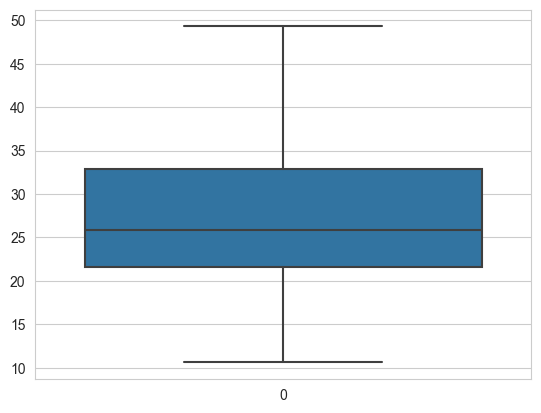

In [88]:
sns.boxplot(data1['aspartate_aminotransferase'])          

## Bilirubin 

In [89]:
Q1_bilirubin = 5.3
Q3_bilirubin = 11.2
IQR_bilirubin = Q3_bilirubin - Q1_bilirubin 
IQR_bilirubin    

5.8999999999999995

In [90]:
Q3_bilirubin+1.5*IQR_bilirubin #UE    

20.049999999999997

In [91]:
Q1_bilirubin-1.5*IQR_bilirubin #LE    

-3.55

In [92]:
upper_bilirubin = np.where(data1['bilirubin'] > (Q3_bilirubin+1.5*IQR_bilirubin)) 
upper_bilirubin    

(array([  9,  18,  22,  29,  37,  69,  85,  90, 111, 114, 128, 134, 164,
        173, 176, 237, 269, 270, 295, 307, 320, 434, 460, 552, 553, 558,
        563, 567, 572, 587, 588, 589, 590, 594, 595, 596, 597, 598, 599,
        600, 601, 604, 605, 607, 609, 610, 612], dtype=int64),)

In [93]:
lower_bilirubin = np.where(data1['bilirubin'] < (Q1_bilirubin-1.5*IQR_bilirubin)) 
lower_bilirubin     

(array([], dtype=int64),)

In [94]:
probable_outliers_bilirubin = [ 9,  18,  22,  29,  37,  69,  85,  90, 111, 114, 128, 134, 164,
        173, 176, 237, 269, 270, 295, 307, 320, 434, 460, 552, 553, 558,
        563, 567, 572, 587, 588, 589, 590, 594, 595, 596, 597, 598, 599,
        600, 601, 604, 605, 607, 609, 610, 612 ]

def outliers_to_nan(data1,bilirubin, probable_outliers_bilirubin):
    for i in probable_outliers_bilirubin:
        data1.at[i,bilirubin] = None
    return data1 

data1 = outliers_to_nan(data1, 'bilirubin', probable_outliers_bilirubin)            

In [95]:
M6 = 11.396748     

In [96]:
data1['bilirubin']=data1['bilirubin'].fillna(M6)                

<AxesSubplot: >

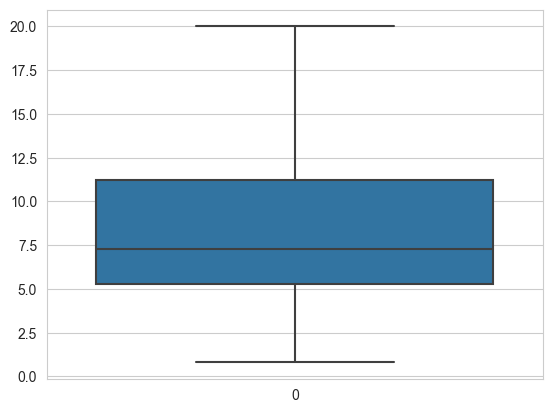

In [97]:
sns.boxplot(data1['bilirubin'])       

## Cholinesterase  

In [98]:
Q1_cholinesterase = 6.935
Q3_cholinesterase = 9.59
IQR_cholinesterase = Q3_cholinesterase - Q1_cholinesterase 
IQR_cholinesterase     

2.6550000000000002

In [99]:
Q3_cholinesterase+1.5*IQR_cholinesterase #UE    

13.5725

In [100]:
Q1_cholinesterase-1.5*IQR_cholinesterase #LE     

2.9524999999999992

In [101]:
upper_cholinesterase = np.where(data1['cholinesterase'] > (Q3_cholinesterase+1.5*IQR_cholinesterase)) 
upper_cholinesterase     

(array([ 91, 108, 183, 205, 209, 231, 235, 536, 548, 555], dtype=int64),)

In [102]:
lower_cholinesterase = np.where(data1['cholinesterase'] < (Q1_cholinesterase-1.5*IQR_cholinesterase)) 
lower_cholinesterase    

(array([587, 589, 590, 593, 595, 596, 597, 599, 600, 601, 604, 605, 611,
        612], dtype=int64),)

In [103]:
probable_outliers_cholinesterase = [ 91, 108, 183, 205, 209, 231, 235, 536, 548, 555,587, 589, 590, 593, 595, 596, 597, 599, 600, 601, 604, 605, 611,
        612 ]

def outliers_to_nan(data1,cholinesterase, probable_outliers_cholinesterase):
    for i in probable_outliers_cholinesterase:
        data1.at[i,cholinesterase] = None
    return data1 

data1 = outliers_to_nan(data1, 'cholinesterase', probable_outliers_cholinesterase)            

In [104]:
M7 = 8.196634    

In [105]:
data1['cholinesterase']=data1['cholinesterase'].fillna(M7)                  

<AxesSubplot: >

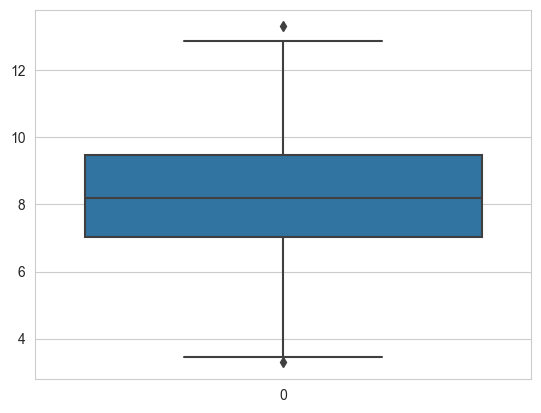

In [106]:
sns.boxplot(data1['cholinesterase'])        

## Cholesterol  

In [107]:
Q1_cholesterol = 4.62
Q3_cholesterol = 6.055
IQR_cholesterol = Q3_cholesterol - Q1_cholesterol 
IQR_cholesterol     

1.4349999999999996

In [108]:
Q3_cholesterol+1.5*IQR_cholesterol #UE    

8.2075

In [109]:
Q1_cholesterol-1.5*IQR_cholesterol #LE     

2.4675000000000007

In [110]:
upper_cholesterol = np.where(data1['cholesterol'] > (Q3_cholesterol+1.5*IQR_cholesterol)) 
upper_cholesterol    

(array([ 89, 116, 125, 184, 205, 231, 382, 440, 499, 553], dtype=int64),)

In [111]:
lower_cholesterol = np.where(data1['cholesterol'] < (Q1_cholesterol-1.5*IQR_cholesterol)) 
lower_cholesterol     

(array([596, 597], dtype=int64),)

In [112]:
probable_outliers_cholesterol = [89, 116, 125, 184, 205, 231, 382, 440, 499, 553,596, 597]

def outliers_to_nan(data1,cholesterol, probable_outliers_cholesterol):
    for i in probable_outliers_cholesterol:
        data1.at[i,cholesterol] = None
    return data1 

data1 = outliers_to_nan(data1, 'cholesterol', probable_outliers_cholesterol)      

In [113]:
M8 = 5.368099   

In [114]:
data1['cholesterol']=data1['cholesterol'].fillna(M8)                   

<AxesSubplot: >

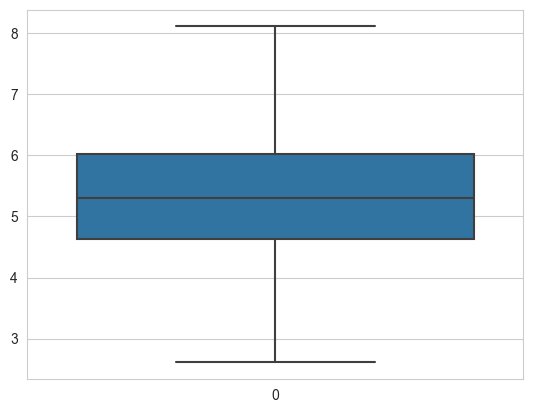

In [115]:
sns.boxplot(data1['cholesterol'])           

## Creatinina  

In [116]:
Q1_creatinina = 67.00
Q3_creatinina = 88.00
IQR_creatinina = Q3_creatinina - Q1_creatinina 
IQR_creatinina    

21.0

In [117]:
Q3_creatinina+1.5*IQR_creatinina #UE    

119.5

In [118]:
Q1_creatinina-1.5*IQR_creatinina #LE    

35.5

In [119]:
upper_creatinina = np.where(data1['creatinina'] > (Q3_creatinina+1.5*IQR_creatinina)) 
upper_creatinina     

(array([315, 533, 559, 586, 591, 606, 607, 609], dtype=int64),)

In [120]:
lower_creatinina = np.where(data1['creatinina'] < (Q1_creatinina-1.5*IQR_creatinina)) 
lower_creatinina    

(array([220, 534, 537, 539], dtype=int64),)

In [121]:
probable_outliers_creatinina = [315, 533, 559, 586, 591, 606, 607, 609,220, 534, 537, 539 ]

def outliers_to_nan(data1,creatinina, probable_outliers_creatinina):
    for i in probable_outliers_creatinina:
        data1.at[i,creatinina] = None
    return data1 

data1 = outliers_to_nan(data1, 'creatinina', probable_outliers_creatinina)    

In [122]:
M9 =  81.287805    

In [123]:
data1['creatinina']=data1['creatinina'].fillna(M9)         

<AxesSubplot: >

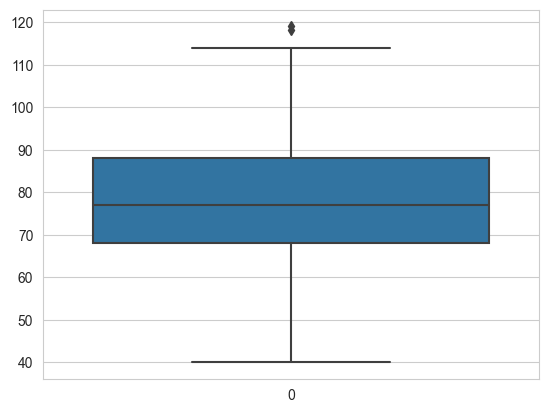

In [124]:
sns.boxplot(data1['creatinina'])       

## Gamma_glutamyl_transferase  

In [125]:
Q1_gamma_glutamyl_transferase = 15.70
Q3_gamma_glutamyl_transferase = 40.20
IQR_gamma_glutamyl_transferase = Q3_gamma_glutamyl_transferase - Q1_gamma_glutamyl_transferase 
IQR_gamma_glutamyl_transferase      

24.500000000000004

In [126]:
Q3_gamma_glutamyl_transferase+1.5*IQR_gamma_glutamyl_transferase #UE    

76.95000000000002

In [127]:
Q1_gamma_glutamyl_transferase-1.5*IQR_gamma_glutamyl_transferase #LE    

-21.050000000000008

In [128]:
upper_gamma_glutamyl_transferase = np.where(data1['gamma_glutamyl_transferase'] > (Q3_gamma_glutamyl_transferase+1.5*IQR_gamma_glutamyl_transferase)) 
upper_gamma_glutamyl_transferase     

(array([  5,  22,  35,  67,  71,  84,  94, 123, 140, 144, 146, 168, 189,
        194, 205, 216, 233, 241, 260, 299, 307, 308, 314, 316, 401, 458,
        475, 478, 496, 533, 534, 538, 539, 542, 553, 555, 556, 558, 559,
        563, 564, 565, 570, 571, 572, 574, 576, 583, 584, 585, 586, 587,
        590, 591, 592, 593, 595, 598, 602, 603, 605, 606, 607, 609, 610],
       dtype=int64),)

In [129]:
lower_gamma_glutamyl_transferase = np.where(data1['gamma_glutamyl_transferase'] < (Q1_gamma_glutamyl_transferase-1.5*IQR_gamma_glutamyl_transferase)) 
lower_gamma_glutamyl_transferase    

(array([], dtype=int64),)

In [130]:
probable_outliers_gamma_glutamyl_transferase = [5,  22,  35,  67,  71,  84,  94, 123, 140, 144, 146, 168, 189,
        194, 205, 216, 233, 241, 260, 299, 307, 308, 314, 316, 401, 458,
        475, 478, 496, 533, 534, 538, 539, 542, 553, 555, 556, 558, 559,
        563, 564, 565, 570, 571, 572, 574, 576, 583, 584, 585, 586, 587,
        590, 591, 592, 593, 595, 598, 602, 603, 605, 606, 607, 609, 610 ]

def outliers_to_nan(data1,gamma_glutamyl_transferase, probable_outliers_gamma_glutamyl_transferase):
    for i in probable_outliers_gamma_glutamyl_transferase:
        data1.at[i,gamma_glutamyl_transferase] = None
    return data1 

data1 = outliers_to_nan(data1, 'gamma_glutamyl_transferase', probable_outliers_gamma_glutamyl_transferase)      

In [131]:
M10 = 39.533171     

In [132]:
data1['gamma_glutamyl_transferase']=data1['gamma_glutamyl_transferase'].fillna(M10)           

<AxesSubplot: >

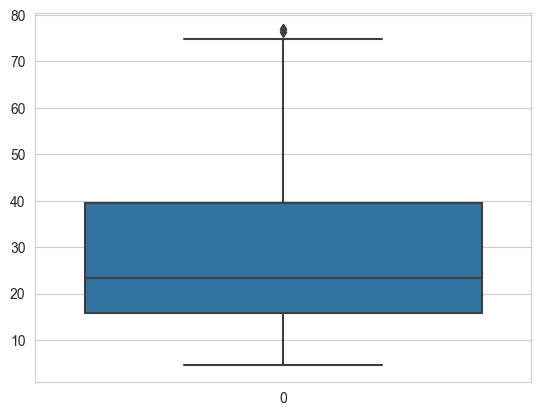

In [133]:
sns.boxplot(data1['gamma_glutamyl_transferase'])       

## Protein  

In [134]:
Q1_protein = 69.30
Q3_protein = 75.40
IQR_protein = Q3_protein - Q1_protein 
IQR_protein       

6.1000000000000085

In [135]:
Q3_protein+1.5*IQR_protein #UE     

84.55000000000001

In [136]:
Q1_protein-1.5*IQR_protein #LE     

60.149999999999984

In [137]:
upper_protein = np.where(data1['protein'] > (Q3_protein+1.5*IQR_protein)) 
upper_protein     

(array([287, 545, 563], dtype=int64),)

In [138]:
lower_protein = np.where(data1['protein'] < (Q1_protein-1.5*IQR_protein)) 
lower_protein      

(array([ 27,  59, 312, 315, 483, 509, 527, 533, 534, 535, 537, 538, 539,
        586, 597, 604, 606], dtype=int64),)

In [139]:
probable_outliers_protein = [287, 545, 563,27,  59, 312, 315, 483, 509, 527, 533, 534, 535, 537, 538, 539,
        586, 597, 604, 606 ]

def outliers_to_nan(data1,protein, probable_outliers_protein):
    for i in probable_outliers_protein:
        data1.at[i,protein] = None
    return data1 

data1 = outliers_to_nan(data1, 'protein', probable_outliers_protein)        

In [140]:
M11 =  72.044137     

In [141]:
data1['protein']=data1['protein'].fillna(M11)              

<AxesSubplot: >

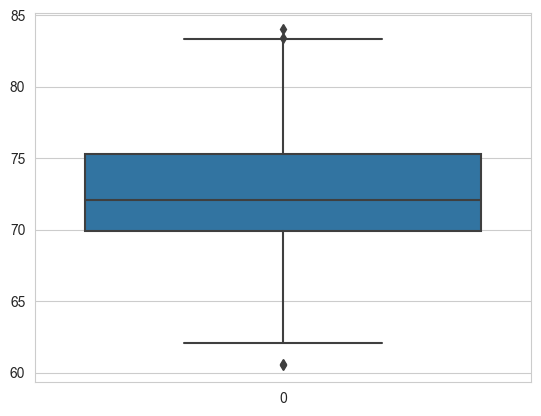

In [142]:
sns.boxplot(data1['protein'])           

In [143]:
data1.describe()     

,age,albumin,alkaline_phosphatase,alanine_aminotransferase,aspartate_aminotransferase,bilirubin,cholinesterase,cholesterol,creatinina,gamma_glutamyl_transferase,protein
count,615.000000,615.000000,615.000000,615.000000,615.000000,615.000000,615.000000,615.000000,615.000000,615.000000,615.000000
mean,47.360013,42.039619,66.365830,24.137854,27.100530,8.218125,8.234275,5.323038,78.157486,27.635538,72.471101
std,9.983819,4.214554,18.150149,10.909590,7.310649,3.972665,1.795801,1.011124,14.217353,15.471906,4.253305
min,19.000000,29.200000,19.100000,0.900000,10.600000,0.800000,3.290000,2.610000,40.000000,4.500000,60.500000
25%,39.000000,39.200000,53.150000,16.400000,21.600000,5.300000,7.030000,4.625000,68.000000,15.700000,69.900000
50%,47.000000,41.800000,66.700000,23.000000,25.900000,7.300000,8.196634,5.310000,77.000000,23.300000,72.100000
75%,54.000000,45.100000,77.750000,29.400000,32.900000,11.200000,9.465000,6.020000,88.000000,39.533171,75.300000
max,76.000000,54.400000,117.300000,57.700000,49.300000,20.000000,13.300000,8.110000,119.000000,76.900000,84.000000


In [144]:
data1   

,category,age,sex,albumin,alkaline_phosphatase,alanine_aminotransferase,aspartate_aminotransferase,bilirubin,cholinesterase,cholesterol,creatinina,gamma_glutamyl_transferase,protein
0,no_disease,32.00000,m,38.500000,52.50000,7.700000,22.100000,7.500000,6.930000,3.230000,106.000000,12.100000,69.000000
1,no_disease,32.00000,m,38.500000,70.30000,18.000000,24.700000,3.900000,11.170000,4.800000,74.000000,15.600000,76.500000
2,no_disease,32.00000,m,46.900000,74.70000,36.200000,34.786341,6.100000,8.840000,5.200000,86.000000,33.200000,79.300000
3,no_disease,32.00000,m,43.200000,52.00000,30.600000,22.600000,18.900000,7.330000,4.740000,80.000000,33.800000,75.700000
4,no_disease,32.00000,m,39.200000,74.10000,32.600000,24.800000,9.600000,9.150000,4.320000,76.000000,29.900000,68.700000
5,no_disease,32.00000,m,41.600000,43.30000,18.500000,19.700000,12.300000,9.920000,6.050000,111.000000,39.533171,74.000000
6,no_disease,32.00000,m,46.300000,41.30000,17.500000,17.800000,8.500000,7.010000,4.790000,70.000000,16.900000,74.500000
7,no_disease,32.00000,m,42.200000,41.90000,35.800000,31.100000,16.100000,5.820000,4.600000,109.000000,21.500000,67.100000
8,no_disease,32.00000,m,50.900000,65.50000,23.200000,21.200000,6.900000,8.690000,4.100000,83.000000,13.700000,71.300000
9,no_disease,32.00000,m,42.400000,86.30000,20.300000,20.000000,11.396748,5.460000,4.450000,81.000000,15.900000,69.900000


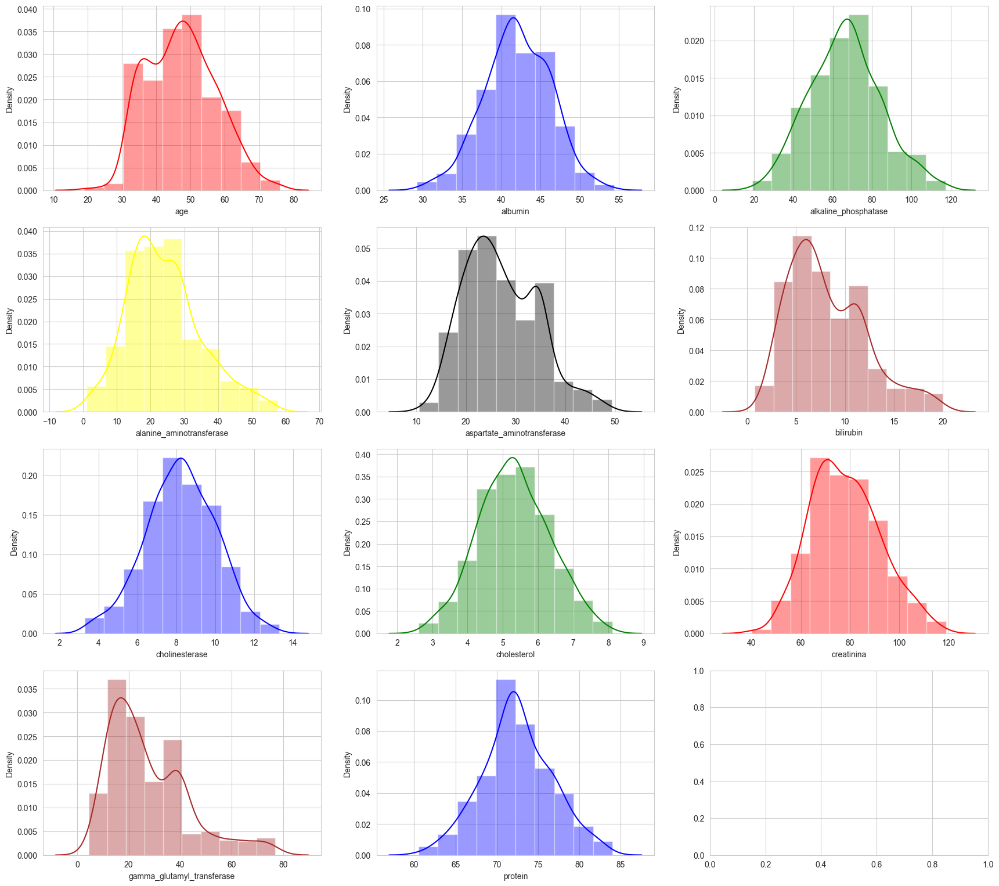

In [145]:
import seaborn as sns

plt.figure(figsize=(21,19)) 

plt.subplot(4,3,1)
sns.distplot(data1['age'],bins=10,  kde = True, color =  'red' )      
plt.subplot(4,3,2)
sns.distplot(data1['albumin'],bins=10,  kde = True, color =  'blue' )      
plt.subplot(4,3,3)
sns.distplot(data1['alkaline_phosphatase'],bins=10,  kde = True, color =  'green' )      
plt.subplot(4,3,4)
sns.distplot(data1['alanine_aminotransferase'],bins=10,  kde = True, color =  'yellow' )      
plt.subplot(4,3,5) 
sns.distplot(data1['aspartate_aminotransferase'],bins=10,  kde = True, color =  'black' )      
plt.subplot(4,3,6)
sns.distplot(data1['bilirubin'],bins=10,  kde = True, color =  'brown' )      
plt.subplot(4,3,7)
sns.distplot(data1['cholinesterase'],bins=10,  kde = True, color =  'blue' )      
plt.subplot(4,3,8)
sns.distplot(data1['cholesterol'],bins=10,  kde = True, color =  'green' )      
plt.subplot(4,3,9)
sns.distplot(data1['creatinina'],bins=10,  kde = True, color =  'red' )      
plt.subplot(4,3,10)
sns.distplot(data1['gamma_glutamyl_transferase'],bins=10,  kde = True, color =  'brown' )      
plt.subplot(4,3,11)
sns.distplot(data1['protein'],bins=10,  kde = True, color =  'blue' )      
plt.subplot(4,3,12)

plt.show()         

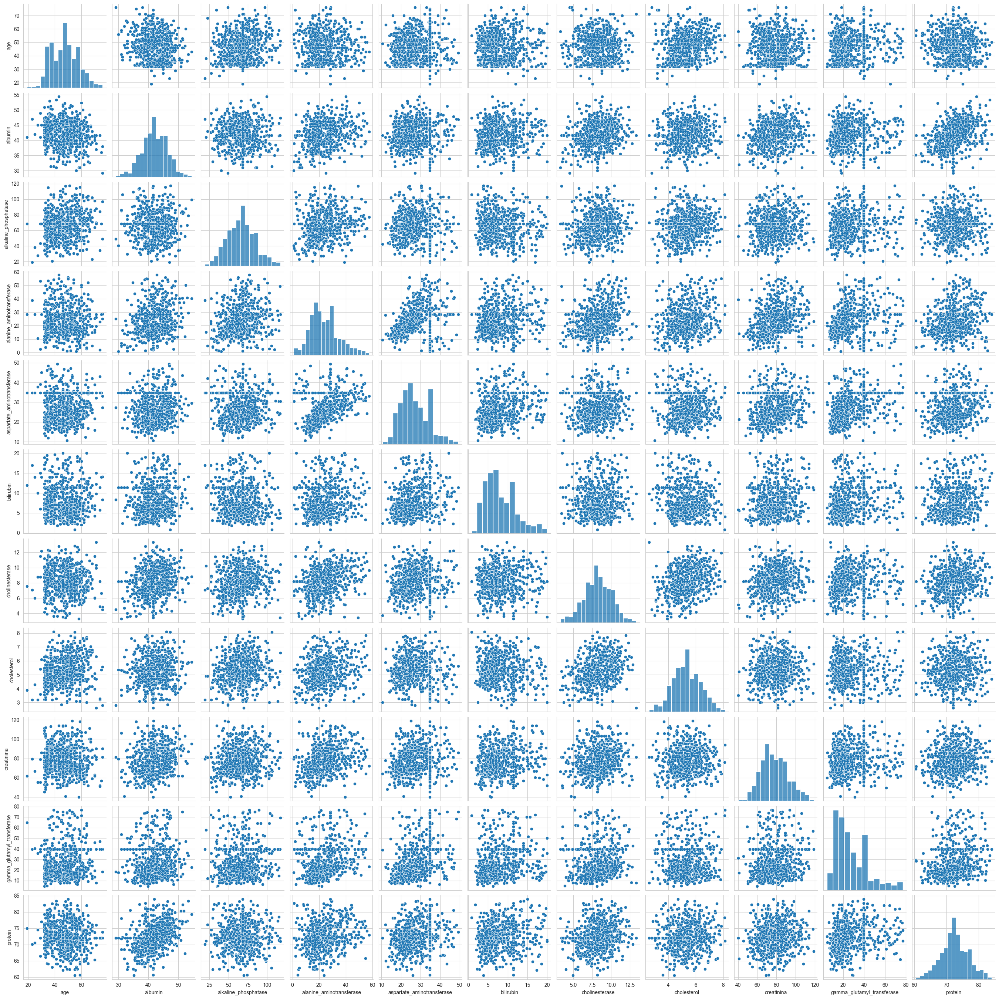

In [146]:
sns.set_style(style='whitegrid')
sns.pairplot(data1)     

<AxesSubplot: >

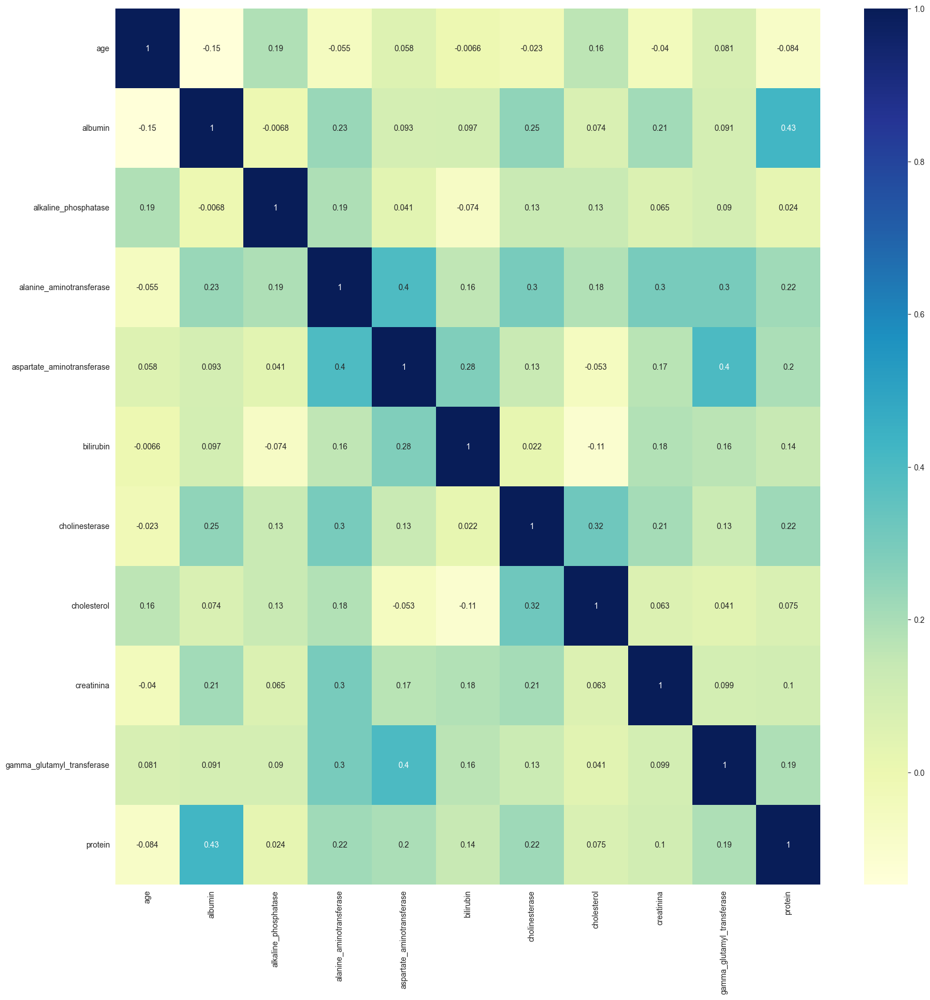

In [147]:
plt.figure(figsize=(20,20))
sns.heatmap(data1.corr(),annot=True,cmap='YlGnBu')

In [148]:
obj_colum = data1.select_dtypes(include='object').columns.tolist() 
obj_colum     

['category', 'sex']

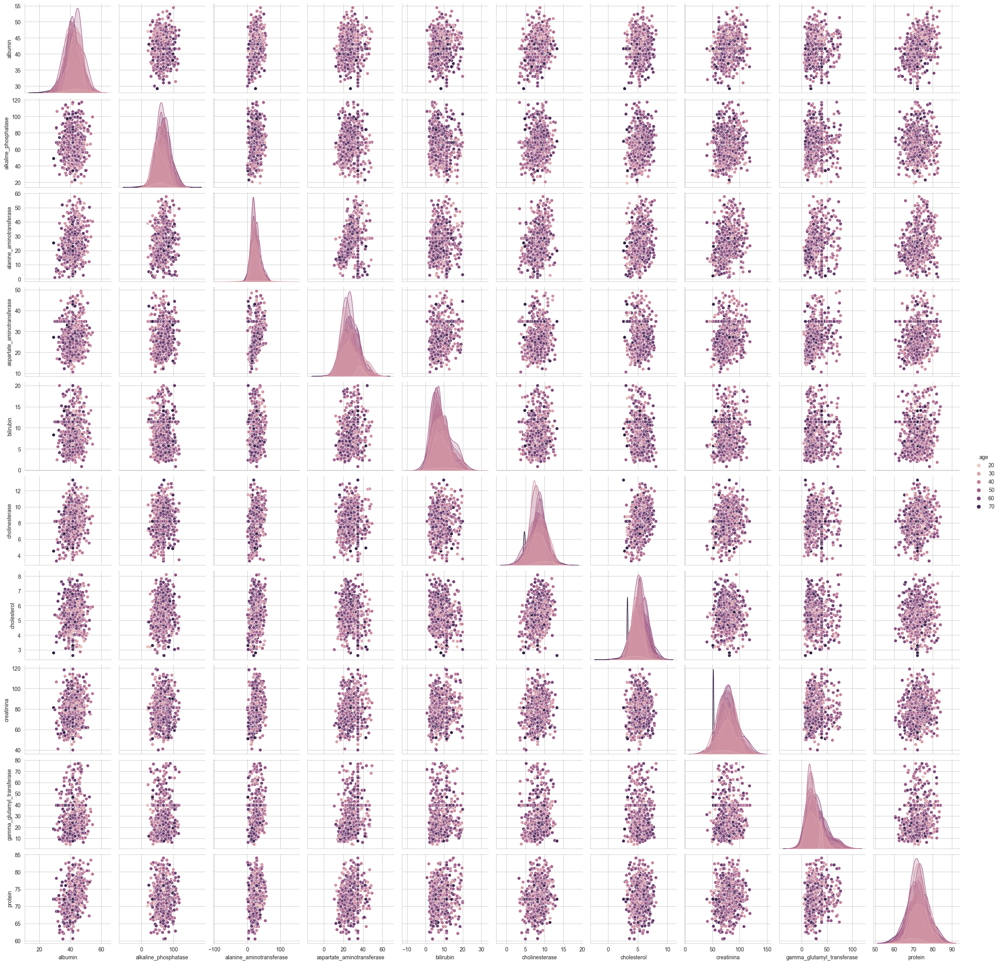

In [149]:
import seaborn  
seaborn.pairplot(data1,hue='age')
plt.show()          

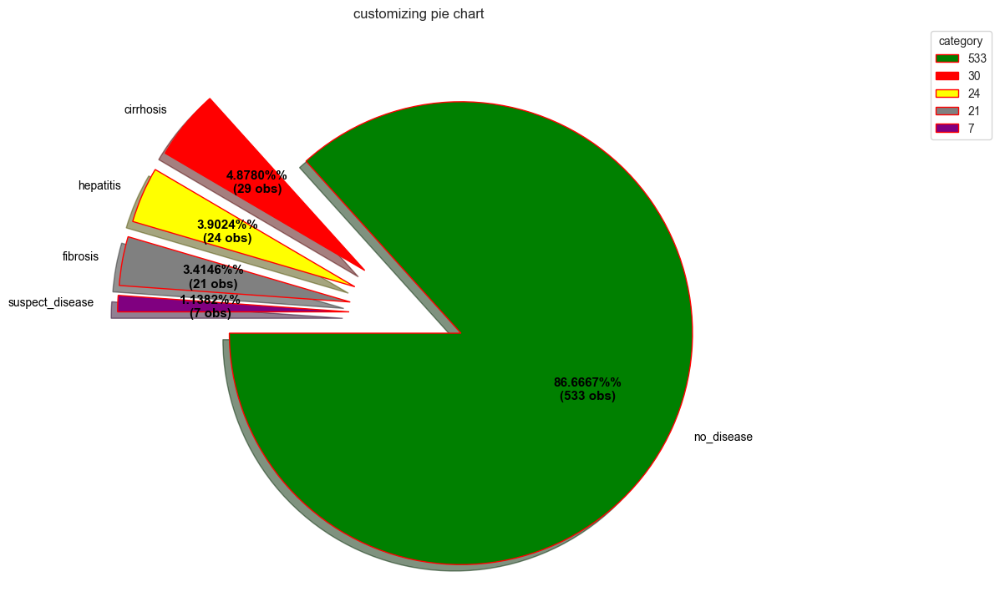

In [150]:
### Customizing pie chart

explode = (0.2,0.3,0.3,0.3,0.3)
colors = ("green","red","yellow","grey","purple")
wp = {'linewidth': 1,'edgecolor': "red"}
def func(pct,allvalues):
    absolute = int(pct / 100.*np.sum(allvalues))
    return "{:.4f}%%\n({:d} obs)".format(pct, absolute)
fig,ax = plt.subplots(figsize =(21,9))
wedges,texts,autotexts = ax.pie(data1['category'].value_counts(),
                                autopct = lambda pct:func(pct,data1['category'].value_counts()),
                                explode = explode,
                                shadow = True,
                                labels = ('no_disease','cirrhosis','hepatitis','fibrosis','suspect_disease'), 
                                colors = colors,
                                startangle = 180,
                                wedgeprops = wp,
                                textprops = dict(color = "black")) 
ax.legend(wedges, data1['category'].value_counts(), 
          title ="category",
          loc = "upper right",
          bbox_to_anchor =(1,0,0.5,1)) 
plt.setp(autotexts, size= 11, weight = "bold")
ax.set_title("customizing pie chart")
plt.show()                                                           

In [151]:
data2 = data1.copy()  

In [152]:
###Converting categorical data to numerical data (category and sex columns)
data2['sex'] = np.where(data2['sex'].str.contains("m"), 1, 0) # 1=m , 0=f
data2=pd.get_dummies(data2,columns=['category'])  

In [153]:
data2.info()   

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 615 entries, 0 to 614
Data columns (total 17 columns):
 #   Column                      Non-Null Count  Dtype  
---  ------                      --------------  -----  
 0   age                         615 non-null    float64
 1   sex                         615 non-null    int32  
 2   albumin                     615 non-null    float64
 3   alkaline_phosphatase        615 non-null    float64
 4   alanine_aminotransferase    615 non-null    float64
 5   aspartate_aminotransferase  615 non-null    float64
 6   bilirubin                   615 non-null    float64
 7   cholinesterase              615 non-null    float64
 8   cholesterol                 615 non-null    float64
 9   creatinina                  615 non-null    float64
 10  gamma_glutamyl_transferase  615 non-null    float64
 11  protein                     615 non-null    float64
 12  category_ cirrhosis         615 non-null    uint8  
 13  category_ fibrosis          615 non

In [154]:
data2['category_ cirrhosis'] = pd.to_numeric(data2['category_ cirrhosis'], errors='coerce')
data2['category_ fibrosis'] = pd.to_numeric(data2['category_ fibrosis'], errors='coerce')
data2['category_ hepatitis'] = pd.to_numeric(data2['category_ hepatitis'], errors='coerce')
data2['category_ no_disease'] = pd.to_numeric(data2['category_ no_disease'], errors='coerce')
data2['category_suspect_disease'] = pd.to_numeric(data2['category_suspect_disease'], errors='coerce')   

In [155]:
data2.dtypes   

age                           float64
sex                             int32
albumin                       float64
alkaline_phosphatase          float64
alanine_aminotransferase      float64
aspartate_aminotransferase    float64
bilirubin                     float64
cholinesterase                float64
cholesterol                   float64
creatinina                    float64
gamma_glutamyl_transferase    float64
protein                       float64
category_ cirrhosis             uint8
category_ fibrosis              uint8
category_ hepatitis             uint8
category_ no_disease            uint8
category_suspect_disease        uint8
dtype: object

# Feature Engineering  

<AxesSubplot: >

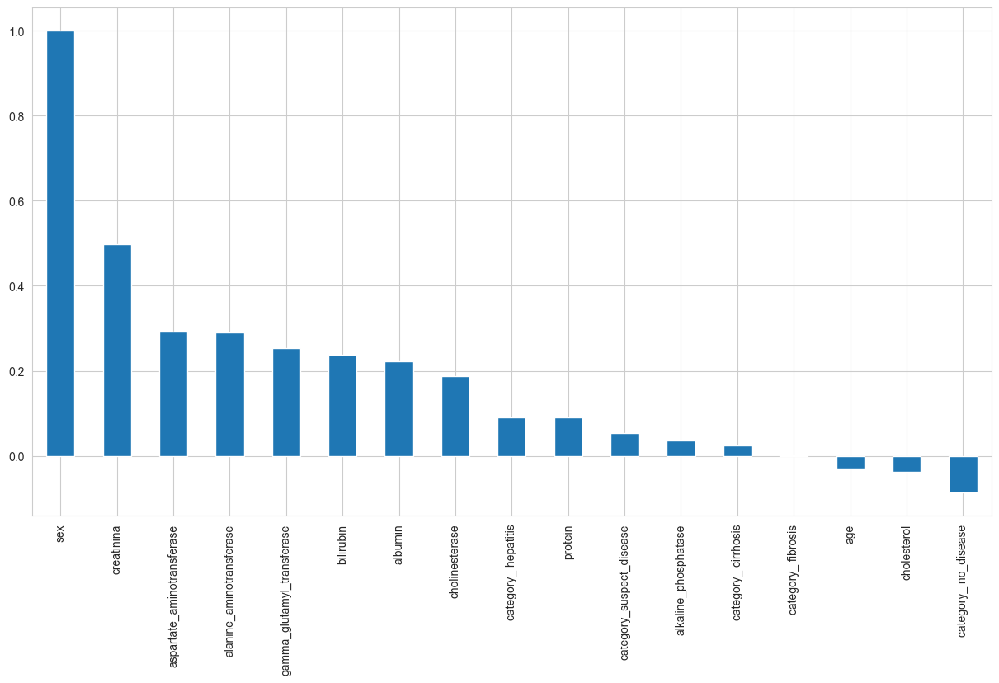

In [156]:
plt.figure(figsize=(15,8)) 
data2.corr()['sex'].sort_values(ascending = False).plot(kind='bar')   

<AxesSubplot: >

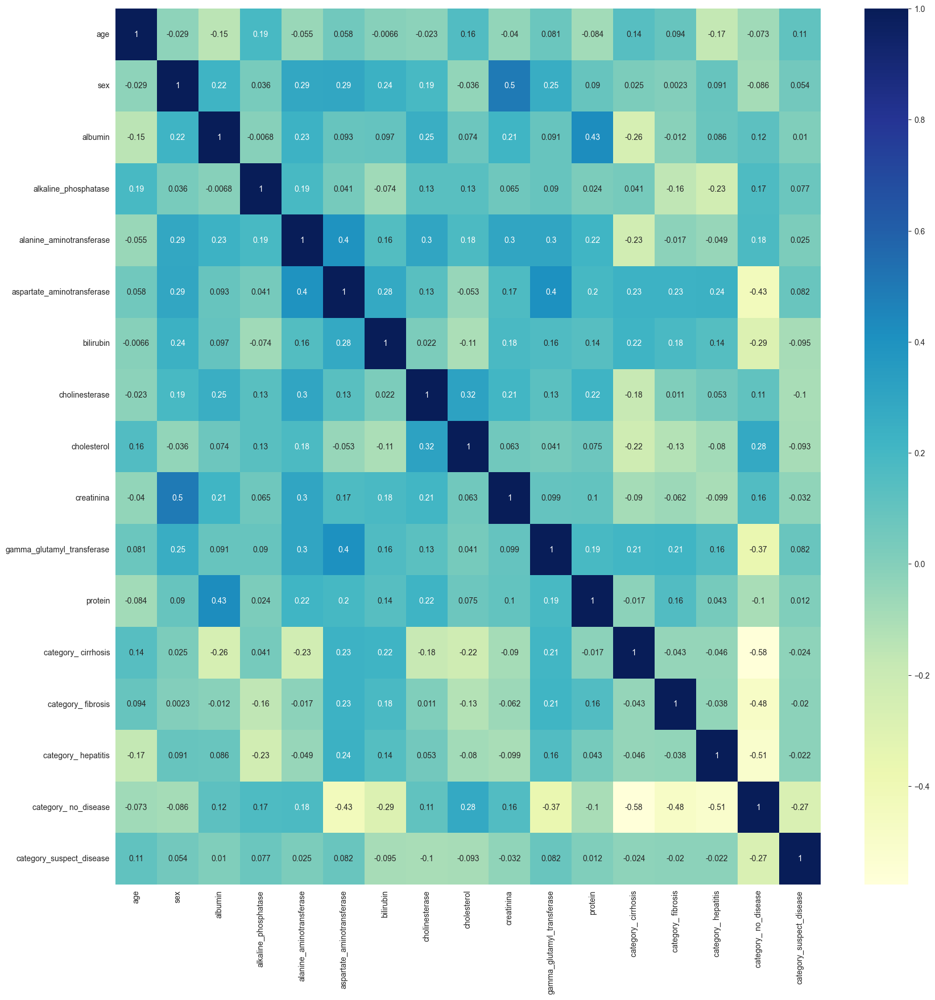

In [157]:
#Heat Map
plt.figure(figsize=(20,20))
sns.heatmap(data2.corr(),annot=True,cmap='YlGnBu')   

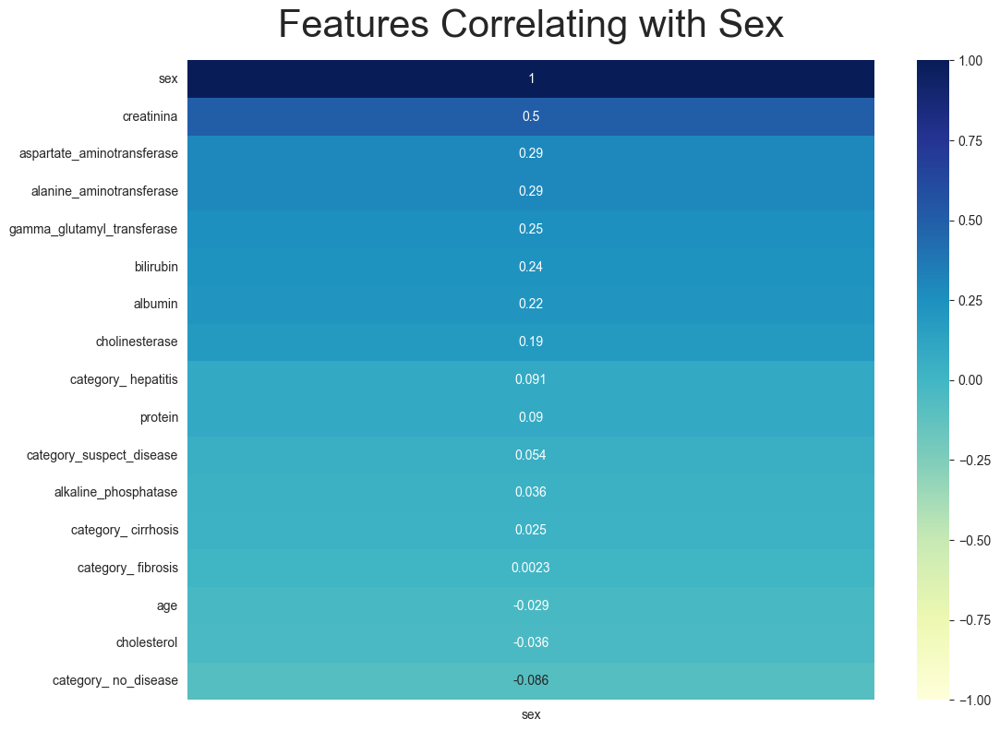

In [158]:
plt.figure(figsize=(12, 9))
heatmap = sns.heatmap(data2.corr()[['sex']].sort_values(by='sex', ascending=False), vmin=-1, vmax=1, annot=True, cmap='YlGnBu')
heatmap.set_title('Features Correlating with Sex', fontdict={'fontsize':30}, pad=18);         

In [159]:
data1   

,category,age,sex,albumin,alkaline_phosphatase,alanine_aminotransferase,aspartate_aminotransferase,bilirubin,cholinesterase,cholesterol,creatinina,gamma_glutamyl_transferase,protein
0,no_disease,32.00000,m,38.500000,52.50000,7.700000,22.100000,7.500000,6.930000,3.230000,106.000000,12.100000,69.000000
1,no_disease,32.00000,m,38.500000,70.30000,18.000000,24.700000,3.900000,11.170000,4.800000,74.000000,15.600000,76.500000
2,no_disease,32.00000,m,46.900000,74.70000,36.200000,34.786341,6.100000,8.840000,5.200000,86.000000,33.200000,79.300000
3,no_disease,32.00000,m,43.200000,52.00000,30.600000,22.600000,18.900000,7.330000,4.740000,80.000000,33.800000,75.700000
4,no_disease,32.00000,m,39.200000,74.10000,32.600000,24.800000,9.600000,9.150000,4.320000,76.000000,29.900000,68.700000
5,no_disease,32.00000,m,41.600000,43.30000,18.500000,19.700000,12.300000,9.920000,6.050000,111.000000,39.533171,74.000000
6,no_disease,32.00000,m,46.300000,41.30000,17.500000,17.800000,8.500000,7.010000,4.790000,70.000000,16.900000,74.500000
7,no_disease,32.00000,m,42.200000,41.90000,35.800000,31.100000,16.100000,5.820000,4.600000,109.000000,21.500000,67.100000
8,no_disease,32.00000,m,50.900000,65.50000,23.200000,21.200000,6.900000,8.690000,4.100000,83.000000,13.700000,71.300000
9,no_disease,32.00000,m,42.400000,86.30000,20.300000,20.000000,11.396748,5.460000,4.450000,81.000000,15.900000,69.900000


In [160]:
data1['sex'] = np.where(data1['sex'].str.contains("m"), 1, 0) # 1=m , 0=f   

In [161]:
data3= data1.copy()   

In [162]:
data3['sex'].value_counts()   

1    377
0    238
Name: sex, dtype: int64

In [163]:
data3['category'].value_counts()    

 no_disease        533
 cirrhosis          30
 hepatitis          24
 fibrosis           21
suspect_disease      7
Name: category, dtype: int64

# Mean Correlation  

In [164]:
corr_matrix = data3.corr()
corr_matrix   

,age,sex,albumin,alkaline_phosphatase,alanine_aminotransferase,aspartate_aminotransferase,bilirubin,cholinesterase,cholesterol,creatinina,gamma_glutamyl_transferase,protein
age,1.000000,-0.028552,-0.147085,0.187209,-0.055460,0.058150,-0.006564,-0.022810,0.159862,-0.039669,0.081190,-0.084210
sex,-0.028552,1.000000,0.222249,0.035631,0.291006,0.291967,0.237123,0.187778,-0.036441,0.497887,0.254537,0.090068
albumin,-0.147085,0.222249,1.000000,-0.006822,0.233149,0.092558,0.096867,0.251342,0.074187,0.212457,0.090572,0.426088
alkaline_phosphatase,0.187209,0.035631,-0.006822,1.000000,0.192663,0.040875,-0.073856,0.132985,0.132311,0.065266,0.090467,0.024253
alanine_aminotransferase,-0.055460,0.291006,0.233149,0.192663,1.000000,0.398044,0.155730,0.298708,0.180044,0.299763,0.298554,0.217125
aspartate_aminotransferase,0.058150,0.291967,0.092558,0.040875,0.398044,1.000000,0.279702,0.134599,-0.053142,0.169201,0.404050,0.196407
bilirubin,-0.006564,0.237123,0.096867,-0.073856,0.155730,0.279702,1.000000,0.021545,-0.107959,0.182375,0.163061,0.137657
cholinesterase,-0.022810,0.187778,0.251342,0.132985,0.298708,0.134599,0.021545,1.000000,0.320656,0.207678,0.125196,0.220576
cholesterol,0.159862,-0.036441,0.074187,0.132311,0.180044,-0.053142,-0.107959,0.320656,1.000000,0.062869,0.041178,0.074823
creatinina,-0.039669,0.497887,0.212457,0.065266,0.299763,0.169201,0.182375,0.207678,0.062869,1.000000,0.099014,0.103313


Here, we can observe that no feature is having a correlation greater than '0.5'. So we are not dropping any feature, as there is no multicollinearity between the variables.  

In [165]:
x = data3[["age","sex","albumin","alkaline_phosphatase","alanine_aminotransferase","aspartate_aminotransferase","bilirubin","cholinesterase","cholesterol","creatinina","gamma_glutamyl_transferase","protein"]]
y = data3["category"]      

In [166]:
from sklearn.model_selection import train_test_split
x_train,x_test,y_train,y_test= train_test_split(x,y,test_size=0.2, random_state = 42)   

In [167]:
x_train  

,age,sex,albumin,alkaline_phosphatase,alanine_aminotransferase,aspartate_aminotransferase,bilirubin,cholinesterase,cholesterol,creatinina,gamma_glutamyl_transferase,protein
83,39.00000,1,36.600000,71.30000,28.900000,25.900000,6.100000,5.700000,4.660000,77.000000,22.600000,66.300000
90,39.00000,1,45.800000,62.50000,20.700000,22.800000,11.396748,8.610000,4.780000,77.000000,15.900000,75.500000
228,53.00000,1,44.500000,61.20000,14.400000,18.100000,8.000000,6.950000,5.000000,70.000000,18.300000,72.000000
509,58.00000,0,41.620195,52.50000,39.500000,34.786341,5.800000,5.150000,3.530000,40.000000,31.200000,72.044137
329,33.00000,0,42.400000,68.28392,14.200000,13.100000,3.400000,8.230000,5.368099,48.000000,25.700000,74.400000
425,48.00000,0,35.200000,45.40000,23.400000,27.100000,4.900000,6.830000,4.350000,70.000000,11.800000,72.100000
79,38.00000,1,40.500000,61.70000,18.600000,24.700000,6.700000,8.470000,6.050000,89.000000,19.600000,75.600000
23,34.00000,1,43.400000,46.10000,28.450814,46.200000,11.300000,7.990000,3.620000,71.000000,35.300000,69.600000
158,46.00000,1,37.300000,91.60000,33.400000,35.900000,2.600000,9.740000,6.730000,78.000000,64.200000,69.900000
292,63.00000,1,40.800000,74.30000,25.000000,27.500000,5.500000,7.740000,6.350000,107.000000,50.400000,69.300000


In [168]:
x_train.shape   

(492, 12)

In [169]:
y_train   

83          no_disease
90          no_disease
228         no_disease
509         no_disease
329         no_disease
425         no_disease
79          no_disease
23          no_disease
158         no_disease
292         no_disease
528         no_disease
192         no_disease
165         no_disease
574           fibrosis
184         no_disease
218         no_disease
9           no_disease
174         no_disease
319         no_disease
321         no_disease
601          cirrhosis
500         no_disease
84          no_disease
402         no_disease
196         no_disease
377         no_disease
417         no_disease
472         no_disease
215         no_disease
468         no_disease
153         no_disease
75          no_disease
92          no_disease
364         no_disease
68          no_disease
15          no_disease
473         no_disease
176         no_disease
88          no_disease
515         no_disease
117         no_disease
399         no_disease
423         no_disease
33         

In [170]:
y_train.shape   

(492,)

In [171]:
y_train.value_counts()   

 no_disease        437
 cirrhosis          21
 fibrosis           15
 hepatitis          15
suspect_disease      4
Name: category, dtype: int64

In [172]:
x_test  

,age,sex,albumin,alkaline_phosphatase,alanine_aminotransferase,aspartate_aminotransferase,bilirubin,cholinesterase,cholesterol,creatinina,gamma_glutamyl_transferase,protein
248,55.0,1,41.620195,65.50000,16.600000,17.500000,2.800000,5.580000,4.390000,65.000000,26.200000,62.400000
365,39.0,0,31.400000,106.00000,16.600000,17.000000,2.400000,5.950000,5.300000,68.000000,22.900000,72.300000
432,48.0,0,43.700000,50.10000,17.300000,26.300000,8.100000,8.150000,5.380000,64.000000,13.400000,73.100000
610,62.0,0,32.000000,68.28392,5.900000,34.786341,11.396748,5.570000,6.300000,55.700000,39.533171,68.500000
132,44.0,1,35.500000,81.70000,27.500000,29.500000,6.400000,8.810000,6.650000,83.000000,24.100000,68.000000
602,61.0,1,39.000000,102.90000,27.300000,34.786341,15.000000,5.380000,4.880000,72.300000,39.533171,73.400000
188,49.0,1,41.200000,96.00000,25.000000,27.700000,15.600000,7.120000,5.610000,92.000000,37.800000,68.700000
2,32.0,1,46.900000,74.70000,36.200000,34.786341,6.100000,8.840000,5.200000,86.000000,33.200000,79.300000
271,59.0,1,38.400000,61.20000,15.900000,27.200000,3.000000,6.880000,6.890000,91.000000,14.000000,64.500000
77,38.0,1,48.400000,44.90000,23.400000,22.100000,7.900000,10.530000,7.510000,87.000000,43.200000,82.600000


In [173]:
y_test  

248         no_disease
365         no_disease
432         no_disease
610          cirrhosis
132         no_disease
602          cirrhosis
188         no_disease
2           no_disease
271         no_disease
77          no_disease
286         no_disease
244         no_disease
109         no_disease
374         no_disease
137         no_disease
367         no_disease
209         no_disease
101         no_disease
204         no_disease
555          hepatitis
441         no_disease
199         no_disease
590          cirrhosis
299         no_disease
544          hepatitis
381         no_disease
522         no_disease
210         no_disease
268         no_disease
611          cirrhosis
10          no_disease
145         no_disease
304         no_disease
375         no_disease
148         no_disease
181         no_disease
514         no_disease
603          cirrhosis
55          no_disease
82          no_disease
110         no_disease
290         no_disease
311         no_disease
390        

# Data Balancing  

synthetic minority over-sampling technique 

In [174]:
from imblearn.over_sampling import SMOTE 
from collections import Counter    

In [175]:
sm= SMOTE(random_state=0,k_neighbors=3)
x_train_smote,y_train_smote=sm.fit_resample(x_train,y_train)   

In [176]:
print("Before smote:",Counter(y_train)) 
print("After smote:",Counter(y_train_smote))  

Before smote: Counter({' no_disease': 437, ' cirrhosis': 21, ' fibrosis': 15, ' hepatitis': 15, 'suspect_disease': 4})
After smote: Counter({' no_disease': 437, ' fibrosis': 437, ' cirrhosis': 437, ' hepatitis': 437, 'suspect_disease': 437})


<AxesSubplot: >

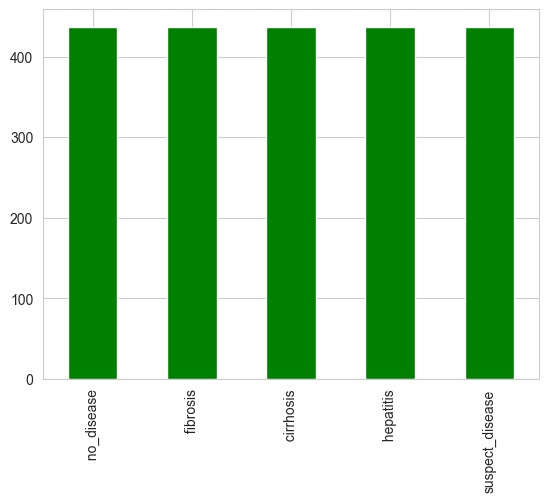

In [177]:
y_train_smote.value_counts().plot.bar(color='green')      

In [178]:
x_train_smote   

,age,sex,albumin,alkaline_phosphatase,alanine_aminotransferase,aspartate_aminotransferase,bilirubin,cholinesterase,cholesterol,creatinina,gamma_glutamyl_transferase,protein
0,39.000000,1,36.600000,71.300000,28.900000,25.900000,6.100000,5.700000,4.660000,77.000000,22.600000,66.300000
1,39.000000,1,45.800000,62.500000,20.700000,22.800000,11.396748,8.610000,4.780000,77.000000,15.900000,75.500000
2,53.000000,1,44.500000,61.200000,14.400000,18.100000,8.000000,6.950000,5.000000,70.000000,18.300000,72.000000
3,58.000000,0,41.620195,52.500000,39.500000,34.786341,5.800000,5.150000,3.530000,40.000000,31.200000,72.044137
4,33.000000,0,42.400000,68.283920,14.200000,13.100000,3.400000,8.230000,5.368099,48.000000,25.700000,74.400000
5,48.000000,0,35.200000,45.400000,23.400000,27.100000,4.900000,6.830000,4.350000,70.000000,11.800000,72.100000
6,38.000000,1,40.500000,61.700000,18.600000,24.700000,6.700000,8.470000,6.050000,89.000000,19.600000,75.600000
7,34.000000,1,43.400000,46.100000,28.450814,46.200000,11.300000,7.990000,3.620000,71.000000,35.300000,69.600000
8,46.000000,1,37.300000,91.600000,33.400000,35.900000,2.600000,9.740000,6.730000,78.000000,64.200000,69.900000
9,63.000000,1,40.800000,74.300000,25.000000,27.500000,5.500000,7.740000,6.350000,107.000000,50.400000,69.300000


In [179]:
y_train_smote   

0            no_disease
1            no_disease
2            no_disease
3            no_disease
4            no_disease
5            no_disease
6            no_disease
7            no_disease
8            no_disease
9            no_disease
10           no_disease
11           no_disease
12           no_disease
13             fibrosis
14           no_disease
15           no_disease
16           no_disease
17           no_disease
18           no_disease
19           no_disease
20            cirrhosis
21           no_disease
22           no_disease
23           no_disease
24           no_disease
25           no_disease
26           no_disease
27           no_disease
28           no_disease
29           no_disease
30           no_disease
31           no_disease
32           no_disease
33           no_disease
34           no_disease
35           no_disease
36           no_disease
37           no_disease
38           no_disease
39           no_disease
40           no_disease
41           no_

In [180]:
trained_smote_data = pd.concat([x_train_smote,y_train_smote], axis=1)
trained_smote_data   

,age,sex,albumin,alkaline_phosphatase,alanine_aminotransferase,aspartate_aminotransferase,bilirubin,cholinesterase,cholesterol,creatinina,gamma_glutamyl_transferase,protein,category
0,39.000000,1,36.600000,71.300000,28.900000,25.900000,6.100000,5.700000,4.660000,77.000000,22.600000,66.300000,no_disease
1,39.000000,1,45.800000,62.500000,20.700000,22.800000,11.396748,8.610000,4.780000,77.000000,15.900000,75.500000,no_disease
2,53.000000,1,44.500000,61.200000,14.400000,18.100000,8.000000,6.950000,5.000000,70.000000,18.300000,72.000000,no_disease
3,58.000000,0,41.620195,52.500000,39.500000,34.786341,5.800000,5.150000,3.530000,40.000000,31.200000,72.044137,no_disease
4,33.000000,0,42.400000,68.283920,14.200000,13.100000,3.400000,8.230000,5.368099,48.000000,25.700000,74.400000,no_disease
5,48.000000,0,35.200000,45.400000,23.400000,27.100000,4.900000,6.830000,4.350000,70.000000,11.800000,72.100000,no_disease
6,38.000000,1,40.500000,61.700000,18.600000,24.700000,6.700000,8.470000,6.050000,89.000000,19.600000,75.600000,no_disease
7,34.000000,1,43.400000,46.100000,28.450814,46.200000,11.300000,7.990000,3.620000,71.000000,35.300000,69.600000,no_disease
8,46.000000,1,37.300000,91.600000,33.400000,35.900000,2.600000,9.740000,6.730000,78.000000,64.200000,69.900000,no_disease
9,63.000000,1,40.800000,74.300000,25.000000,27.500000,5.500000,7.740000,6.350000,107.000000,50.400000,69.300000,no_disease


In [181]:
test_data = pd.concat([x_test,y_test],axis=1)
test_data   

,age,sex,albumin,alkaline_phosphatase,alanine_aminotransferase,aspartate_aminotransferase,bilirubin,cholinesterase,cholesterol,creatinina,gamma_glutamyl_transferase,protein,category
248,55.0,1,41.620195,65.50000,16.600000,17.500000,2.800000,5.580000,4.390000,65.000000,26.200000,62.400000,no_disease
365,39.0,0,31.400000,106.00000,16.600000,17.000000,2.400000,5.950000,5.300000,68.000000,22.900000,72.300000,no_disease
432,48.0,0,43.700000,50.10000,17.300000,26.300000,8.100000,8.150000,5.380000,64.000000,13.400000,73.100000,no_disease
610,62.0,0,32.000000,68.28392,5.900000,34.786341,11.396748,5.570000,6.300000,55.700000,39.533171,68.500000,cirrhosis
132,44.0,1,35.500000,81.70000,27.500000,29.500000,6.400000,8.810000,6.650000,83.000000,24.100000,68.000000,no_disease
602,61.0,1,39.000000,102.90000,27.300000,34.786341,15.000000,5.380000,4.880000,72.300000,39.533171,73.400000,cirrhosis
188,49.0,1,41.200000,96.00000,25.000000,27.700000,15.600000,7.120000,5.610000,92.000000,37.800000,68.700000,no_disease
2,32.0,1,46.900000,74.70000,36.200000,34.786341,6.100000,8.840000,5.200000,86.000000,33.200000,79.300000,no_disease
271,59.0,1,38.400000,61.20000,15.900000,27.200000,3.000000,6.880000,6.890000,91.000000,14.000000,64.500000,no_disease
77,38.0,1,48.400000,44.90000,23.400000,22.100000,7.900000,10.530000,7.510000,87.000000,43.200000,82.600000,no_disease


## Label Encoding

In [182]:
from sklearn import preprocessing
label_encoder = preprocessing.LabelEncoder()   

In [183]:
trained_smote_data['category']= label_encoder.fit_transform(trained_smote_data['category']) 
trained_smote_data  

,age,sex,albumin,alkaline_phosphatase,alanine_aminotransferase,aspartate_aminotransferase,bilirubin,cholinesterase,cholesterol,creatinina,gamma_glutamyl_transferase,protein,category
0,39.000000,1,36.600000,71.300000,28.900000,25.900000,6.100000,5.700000,4.660000,77.000000,22.600000,66.300000,3
1,39.000000,1,45.800000,62.500000,20.700000,22.800000,11.396748,8.610000,4.780000,77.000000,15.900000,75.500000,3
2,53.000000,1,44.500000,61.200000,14.400000,18.100000,8.000000,6.950000,5.000000,70.000000,18.300000,72.000000,3
3,58.000000,0,41.620195,52.500000,39.500000,34.786341,5.800000,5.150000,3.530000,40.000000,31.200000,72.044137,3
4,33.000000,0,42.400000,68.283920,14.200000,13.100000,3.400000,8.230000,5.368099,48.000000,25.700000,74.400000,3
5,48.000000,0,35.200000,45.400000,23.400000,27.100000,4.900000,6.830000,4.350000,70.000000,11.800000,72.100000,3
6,38.000000,1,40.500000,61.700000,18.600000,24.700000,6.700000,8.470000,6.050000,89.000000,19.600000,75.600000,3
7,34.000000,1,43.400000,46.100000,28.450814,46.200000,11.300000,7.990000,3.620000,71.000000,35.300000,69.600000,3
8,46.000000,1,37.300000,91.600000,33.400000,35.900000,2.600000,9.740000,6.730000,78.000000,64.200000,69.900000,3
9,63.000000,1,40.800000,74.300000,25.000000,27.500000,5.500000,7.740000,6.350000,107.000000,50.400000,69.300000,3


In [184]:
test_data['category']= label_encoder.fit_transform(test_data['category'])   

# Splitting into train and test data  

In [185]:
X_TRAIN = trained_smote_data.iloc[:,0:12]
Y_TRAIN = trained_smote_data.iloc[:,12] 
X_TEST = test_data.iloc[:,0:12]
Y_TEST = test_data.iloc[:,12]    

In [186]:
X_TRAIN   

,age,sex,albumin,alkaline_phosphatase,alanine_aminotransferase,aspartate_aminotransferase,bilirubin,cholinesterase,cholesterol,creatinina,gamma_glutamyl_transferase,protein
0,39.000000,1,36.600000,71.300000,28.900000,25.900000,6.100000,5.700000,4.660000,77.000000,22.600000,66.300000
1,39.000000,1,45.800000,62.500000,20.700000,22.800000,11.396748,8.610000,4.780000,77.000000,15.900000,75.500000
2,53.000000,1,44.500000,61.200000,14.400000,18.100000,8.000000,6.950000,5.000000,70.000000,18.300000,72.000000
3,58.000000,0,41.620195,52.500000,39.500000,34.786341,5.800000,5.150000,3.530000,40.000000,31.200000,72.044137
4,33.000000,0,42.400000,68.283920,14.200000,13.100000,3.400000,8.230000,5.368099,48.000000,25.700000,74.400000
5,48.000000,0,35.200000,45.400000,23.400000,27.100000,4.900000,6.830000,4.350000,70.000000,11.800000,72.100000
6,38.000000,1,40.500000,61.700000,18.600000,24.700000,6.700000,8.470000,6.050000,89.000000,19.600000,75.600000
7,34.000000,1,43.400000,46.100000,28.450814,46.200000,11.300000,7.990000,3.620000,71.000000,35.300000,69.600000
8,46.000000,1,37.300000,91.600000,33.400000,35.900000,2.600000,9.740000,6.730000,78.000000,64.200000,69.900000
9,63.000000,1,40.800000,74.300000,25.000000,27.500000,5.500000,7.740000,6.350000,107.000000,50.400000,69.300000


In [187]:
X_TEST  

,age,sex,albumin,alkaline_phosphatase,alanine_aminotransferase,aspartate_aminotransferase,bilirubin,cholinesterase,cholesterol,creatinina,gamma_glutamyl_transferase,protein
248,55.0,1,41.620195,65.50000,16.600000,17.500000,2.800000,5.580000,4.390000,65.000000,26.200000,62.400000
365,39.0,0,31.400000,106.00000,16.600000,17.000000,2.400000,5.950000,5.300000,68.000000,22.900000,72.300000
432,48.0,0,43.700000,50.10000,17.300000,26.300000,8.100000,8.150000,5.380000,64.000000,13.400000,73.100000
610,62.0,0,32.000000,68.28392,5.900000,34.786341,11.396748,5.570000,6.300000,55.700000,39.533171,68.500000
132,44.0,1,35.500000,81.70000,27.500000,29.500000,6.400000,8.810000,6.650000,83.000000,24.100000,68.000000
602,61.0,1,39.000000,102.90000,27.300000,34.786341,15.000000,5.380000,4.880000,72.300000,39.533171,73.400000
188,49.0,1,41.200000,96.00000,25.000000,27.700000,15.600000,7.120000,5.610000,92.000000,37.800000,68.700000
2,32.0,1,46.900000,74.70000,36.200000,34.786341,6.100000,8.840000,5.200000,86.000000,33.200000,79.300000
271,59.0,1,38.400000,61.20000,15.900000,27.200000,3.000000,6.880000,6.890000,91.000000,14.000000,64.500000
77,38.0,1,48.400000,44.90000,23.400000,22.100000,7.900000,10.530000,7.510000,87.000000,43.200000,82.600000


In [188]:
Y_TRAIN  

0       3
1       3
2       3
3       3
4       3
5       3
6       3
7       3
8       3
9       3
10      3
11      3
12      3
13      1
14      3
15      3
16      3
17      3
18      3
19      3
20      0
21      3
22      3
23      3
24      3
25      3
26      3
27      3
28      3
29      3
30      3
31      3
32      3
33      3
34      3
35      3
36      3
37      3
38      3
39      3
40      3
41      3
42      3
43      3
44      3
45      0
46      3
47      3
48      1
49      3
50      3
51      3
52      3
53      3
54      3
55      2
56      3
57      3
58      3
59      3
60      3
61      3
62      3
63      2
64      3
65      3
66      3
67      3
68      3
69      3
70      3
71      3
72      3
73      3
74      3
75      3
76      3
77      3
78      0
79      3
80      2
81      3
82      3
83      3
84      3
85      3
86      3
87      0
88      3
89      3
90      3
91      3
92      3
93      3
94      3
95      3
96      3
97      3
98      3
99      3


In [189]:
Y_TEST  

248    3
365    3
432    3
610    0
132    3
602    0
188    3
2      3
271    3
77     3
286    3
244    3
109    3
374    3
137    3
367    3
209    3
101    3
204    3
555    2
441    3
199    3
590    0
299    3
544    2
381    3
522    3
210    3
268    3
611    0
10     3
145    3
304    3
375    3
148    3
181    3
514    3
603    0
55     3
82     3
110    3
290    3
311    3
390    3
131    3
559    2
30     3
570    1
456    3
551    2
403    3
211    3
447    3
533    4
70     3
260    3
76     3
278    3
585    0
604    0
536    4
24     3
320    3
569    1
398    3
571    1
29     3
264    3
259    3
322    3
550    2
280    3
257    3
140    3
78     3
81     3
227    3
63     3
388    3
72     3
287    3
208    3
575    1
579    1
104    3
450    3
212    3
316    3
6      3
607    0
135    3
235    3
272    3
155    3
538    4
177    3
613    0
86     3
182    3
532    3
284    3
277    3
549    2
548    2
354    3
563    2
234    3
73     3
39     3
163    3
482    3
6

# Model Building  

## Support Vector Machine

In [190]:
from sklearn.svm import SVC 
from sklearn.metrics import classification_report
from sklearn import metrics

model_SVM = SVC(kernel="linear")
model_SVM.fit(X_TRAIN,Y_TRAIN) 

SVC(kernel='linear')

In [191]:
Y_pred_SVM = model_SVM.predict(X_TEST)
Y_pred_SVM 

array([3, 3, 3, 0, 3, 0, 3, 3, 3, 3, 3, 3, 3, 0, 3, 3, 3, 2, 3, 2, 3, 3,
       3, 3, 1, 3, 3, 3, 3, 0, 1, 3, 3, 3, 3, 3, 3, 1, 3, 3, 3, 3, 4, 3,
       3, 3, 3, 0, 3, 0, 3, 3, 3, 2, 3, 3, 2, 3, 2, 1, 3, 2, 0, 1, 3, 2,
       2, 3, 3, 3, 2, 3, 3, 3, 2, 3, 3, 2, 0, 3, 3, 3, 1, 0, 2, 3, 3, 4,
       3, 0, 3, 3, 1, 3, 1, 3, 0, 3, 3, 3, 3, 3, 2, 2, 3, 1, 3, 2, 3, 3,
       3, 3, 2, 3, 2, 1, 3, 3, 3, 3, 3, 3, 3])

In [192]:
pd.Series(Y_pred_SVM).value_counts() 

3    83
2    17
0    11
1    10
4     2
dtype: int64

In [193]:
pd.crosstab(Y_TEST,Y_pred_SVM) 

col_0,0,1,2,3,4
category,,,,,
0,5,2,1,1,0
1,2,2,1,1,0
2,1,3,4,1,0
3,3,2,10,79,2
4,0,1,1,1,0


In [194]:
print(classification_report(Y_TEST,Y_pred_SVM)) 

              precision    recall  f1-score   support

           0       0.45      0.56      0.50         9
           1       0.20      0.33      0.25         6
           2       0.24      0.44      0.31         9
           3       0.95      0.82      0.88        96
           4       0.00      0.00      0.00         3

    accuracy                           0.73       123
   macro avg       0.37      0.43      0.39       123
weighted avg       0.80      0.73      0.76       123



In [195]:
print("Accuracy:",metrics.accuracy_score(Y_TEST,Y_pred_SVM))

Accuracy: 0.7317073170731707


## Logistic Regression

In [196]:
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import classification_report,confusion_matrix,roc_auc_score 

model_logistic = LogisticRegression() 
model_logistic.fit(X_TRAIN,Y_TRAIN)

LogisticRegression()

In [197]:
Y_pred_logistic = model_logistic.predict(X_TEST) 
Y_pred_logistic

array([4, 3, 3, 0, 3, 0, 3, 3, 4, 3, 4, 3, 3, 3, 3, 3, 3, 2, 4, 2, 3, 1,
       3, 4, 2, 3, 3, 3, 3, 0, 2, 3, 3, 3, 3, 3, 4, 3, 3, 3, 3, 3, 4, 3,
       3, 0, 3, 0, 3, 2, 3, 3, 3, 2, 3, 3, 2, 3, 2, 1, 3, 3, 3, 1, 3, 2,
       3, 4, 3, 3, 1, 4, 3, 0, 2, 3, 3, 2, 3, 3, 4, 3, 0, 0, 2, 3, 3, 4,
       3, 0, 3, 3, 3, 3, 4, 3, 0, 3, 3, 4, 3, 3, 2, 2, 3, 1, 3, 2, 3, 3,
       3, 3, 2, 3, 3, 1, 3, 3, 3, 4, 3, 3, 3])

In [198]:
pd.Series(Y_pred_logistic).value_counts() 

3    77
2    16
4    14
0    10
1     6
dtype: int64

In [199]:
pd.crosstab(Y_TEST,Y_pred_logistic) 

col_0,0,1,2,3,4
category,,,,,
0,5,1,1,2,0
1,3,1,1,1,0
2,1,3,5,0,0
3,1,1,8,73,13
4,0,0,1,1,1


In [200]:
print(classification_report(Y_TEST,Y_pred_logistic)) 

              precision    recall  f1-score   support

           0       0.50      0.56      0.53         9
           1       0.17      0.17      0.17         6
           2       0.31      0.56      0.40         9
           3       0.95      0.76      0.84        96
           4       0.07      0.33      0.12         3

    accuracy                           0.69       123
   macro avg       0.40      0.47      0.41       123
weighted avg       0.81      0.69      0.74       123



In [201]:
print("Accuracy:",metrics.accuracy_score(Y_TEST,Y_pred_logistic)) 

Accuracy: 0.6910569105691057


## Random Forest

In [202]:
from sklearn.ensemble import RandomForestClassifier 
from sklearn.model_selection import KFold

num_trees = 100
max_features = 3
kfold = KFold(n_splits = 10, random_state = 42, shuffle=True)

model_random_forests = RandomForestClassifier(n_estimators = num_trees, max_features = max_features)
model_random_forests.fit(X_TRAIN, Y_TRAIN) 

RandomForestClassifier(max_features=3)

In [203]:
Y_pred_random_forests = model_random_forests.predict(X_TEST) 
Y_pred_random_forests 

array([3, 3, 3, 0, 3, 0, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3,
       3, 3, 2, 3, 3, 3, 3, 0, 3, 3, 3, 3, 3, 3, 3, 0, 3, 3, 3, 3, 3, 3,
       3, 3, 3, 1, 3, 2, 3, 3, 3, 3, 3, 3, 3, 3, 0, 1, 3, 3, 3, 1, 3, 1,
       3, 3, 3, 3, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 0, 3, 3, 3, 3, 3,
       3, 3, 3, 3, 3, 3, 3, 3, 0, 3, 3, 3, 3, 3, 2, 2, 3, 1, 3, 3, 3, 3,
       3, 3, 3, 1, 3, 1, 3, 3, 3, 3, 3, 3, 3])

In [204]:
pd.Series(Y_pred_random_forests).value_counts() 

3    104
1      8
0      7
2      4
dtype: int64

In [205]:
pd.crosstab(Y_TEST,Y_pred_random_forests) 

col_0,0,1,2,3
category,,,,
0,6,1,0,2
1,1,4,0,1
2,0,3,4,2
3,0,0,0,96
4,0,0,0,3


In [206]:
print(classification_report(Y_TEST,Y_pred_random_forests)) 

              precision    recall  f1-score   support

           0       0.86      0.67      0.75         9
           1       0.50      0.67      0.57         6
           2       1.00      0.44      0.62         9
           3       0.92      1.00      0.96        96
           4       0.00      0.00      0.00         3

    accuracy                           0.89       123
   macro avg       0.66      0.56      0.58       123
weighted avg       0.88      0.89      0.88       123



In [207]:
print("Accuracy:",metrics.accuracy_score(Y_TEST,Y_pred_random_forests)) 

Accuracy: 0.8943089430894309


## Stacking Ensemble model

In [208]:
from sklearn.ensemble import VotingClassifier 
from sklearn.tree import DecisionTreeClassifier

kfold = KFold(n_splits=10, random_state = 42, shuffle = True)

estimators = []

model1 = LogisticRegression(max_iter=500)
estimators.append(('logistic', model1))
model2 = DecisionTreeClassifier()
estimators.append(('cart', model2))
model3 = SVC()
estimators.append(('svm', model3)) 

model_ensemble = VotingClassifier(estimators)
model_ensemble.fit(X_TRAIN, Y_TRAIN)

VotingClassifier(estimators=[('logistic', LogisticRegression(max_iter=500)),
                             ('cart', DecisionTreeClassifier()),
                             ('svm', SVC())])

In [209]:
Y_pred_ensemble= model_ensemble.predict(X_TEST) 
Y_pred_ensemble

array([4, 3, 3, 0, 3, 0, 3, 3, 3, 3, 4, 3, 3, 0, 3, 3, 3, 3, 4, 0, 3, 3,
       3, 3, 1, 3, 3, 3, 3, 0, 3, 3, 3, 3, 3, 3, 3, 0, 3, 3, 3, 3, 4, 3,
       3, 0, 3, 1, 3, 2, 3, 3, 3, 1, 3, 3, 1, 3, 0, 0, 3, 3, 3, 1, 3, 1,
       3, 4, 3, 3, 1, 1, 3, 2, 0, 3, 3, 3, 3, 3, 4, 3, 1, 0, 3, 3, 3, 4,
       3, 0, 3, 3, 3, 3, 1, 3, 0, 3, 3, 3, 3, 3, 2, 2, 3, 1, 3, 2, 3, 3,
       3, 3, 2, 3, 3, 1, 3, 3, 3, 4, 3, 3, 3])

In [210]:
pd.Series(Y_pred_ensemble).value_counts() 

3    84
0    13
1    12
4     8
2     6
dtype: int64

In [211]:
pd.crosstab(Y_TEST,Y_pred_ensemble)

col_0,0,1,2,3,4
category,,,,,
0,8,0,0,1,0
1,1,4,0,1,0
2,2,4,3,0,0
3,2,2,3,81,8
4,0,2,0,1,0


In [212]:
print(classification_report(Y_TEST,Y_pred_ensemble))

              precision    recall  f1-score   support

           0       0.62      0.89      0.73         9
           1       0.33      0.67      0.44         6
           2       0.50      0.33      0.40         9
           3       0.96      0.84      0.90        96
           4       0.00      0.00      0.00         3

    accuracy                           0.78       123
   macro avg       0.48      0.55      0.49       123
weighted avg       0.85      0.78      0.81       123



In [213]:
print("Accuracy:",metrics.accuracy_score(Y_TEST,Y_pred_ensemble))

Accuracy: 0.7804878048780488


## Xtreme Gradient Boosting

In [214]:
#!pip install xgboost

In [215]:
from xgboost import XGBClassifier

model_XGB = XGBClassifier()
model_XGB.fit(X_TRAIN,Y_TRAIN) 

XGBClassifier(base_score=None, booster=None, callbacks=None,
              colsample_bylevel=None, colsample_bynode=None,
              colsample_bytree=None, early_stopping_rounds=None,
              enable_categorical=False, eval_metric=None, feature_types=None,
              gamma=None, gpu_id=None, grow_policy=None, importance_type=None,
              interaction_constraints=None, learning_rate=None, max_bin=None,
              max_cat_threshold=None, max_cat_to_onehot=None,
              max_delta_step=None, max_depth=None, max_leaves=None,
              min_child_weight=None, missing=nan, monotone_constraints=None,
              n_estimators=100, n_jobs=None, num_parallel_tree=None,
              objective='multi:softprob', predictor=None, ...)

In [216]:
Y_pred_XGB = model_XGB.predict(X_TEST)
Y_pred_XGB 

array([3, 3, 3, 0, 3, 0, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3,
       3, 3, 2, 3, 3, 3, 3, 0, 3, 3, 3, 3, 3, 3, 3, 0, 3, 3, 3, 3, 3, 3,
       3, 0, 3, 1, 3, 2, 3, 3, 3, 4, 3, 3, 3, 3, 2, 1, 3, 3, 3, 1, 3, 3,
       3, 3, 3, 3, 1, 3, 3, 2, 2, 3, 2, 3, 3, 3, 3, 3, 1, 3, 3, 3, 3, 3,
       3, 0, 3, 3, 3, 3, 3, 3, 0, 3, 3, 3, 3, 3, 2, 2, 3, 1, 3, 3, 3, 3,
       3, 3, 3, 1, 3, 2, 3, 3, 3, 3, 3, 3, 3], dtype=int64)

In [217]:
pd.Series(Y_pred_XGB).value_counts()

3    99
2     9
0     7
1     7
4     1
dtype: int64

In [218]:
pd.crosstab(Y_TEST,Y_pred_XGB) 

col_0,0,1,2,3,4
category,,,,,
0,6,1,1,1,0
1,0,4,0,2,0
2,1,2,5,1,0
3,0,0,3,93,0
4,0,0,0,2,1


In [219]:
print(classification_report(Y_TEST,Y_pred_XGB)) 

              precision    recall  f1-score   support

           0       0.86      0.67      0.75         9
           1       0.57      0.67      0.62         6
           2       0.56      0.56      0.56         9
           3       0.94      0.97      0.95        96
           4       1.00      0.33      0.50         3

    accuracy                           0.89       123
   macro avg       0.78      0.64      0.67       123
weighted avg       0.89      0.89      0.88       123



In [220]:
print("Accuracy:",metrics.accuracy_score(Y_TEST,Y_pred_XGB)) 

Accuracy: 0.8861788617886179


## Light Gradient Boosting

In [221]:
#!pip install lightgbm 

In [222]:
import lightgbm as lgb
from lightgbm import LGBMClassifier

model_LGB = LGBMClassifier()
model_LGB.fit(X_TRAIN,Y_TRAIN)

LGBMClassifier()

In [223]:
Y_pred_LGB = model_LGB.predict(X_TEST)
Y_pred_LGB 

array([3, 3, 3, 0, 3, 0, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 3, 3,
       3, 3, 2, 3, 3, 3, 3, 0, 3, 3, 3, 3, 3, 3, 3, 0, 3, 3, 3, 3, 3, 3,
       3, 0, 3, 1, 3, 2, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 3, 3, 3, 1, 3, 3,
       3, 3, 3, 3, 1, 3, 3, 2, 2, 3, 2, 3, 3, 3, 3, 3, 1, 3, 3, 3, 3, 3,
       3, 0, 3, 3, 3, 3, 3, 3, 0, 3, 3, 3, 3, 3, 2, 2, 3, 1, 3, 3, 3, 3,
       3, 3, 3, 3, 3, 1, 3, 3, 3, 3, 3, 3, 3])

In [224]:
pd.Series(Y_pred_LGB).value_counts()

3    100
1      9
0      7
2      7
dtype: int64

In [225]:
pd.crosstab(Y_TEST,Y_pred_LGB) 

col_0,0,1,2,3
category,,,,
0,6,2,0,1
1,0,3,0,3
2,1,4,4,0
3,0,0,3,93
4,0,0,0,3


In [226]:
print(classification_report(Y_TEST,Y_pred_LGB)) 

              precision    recall  f1-score   support

           0       0.86      0.67      0.75         9
           1       0.33      0.50      0.40         6
           2       0.57      0.44      0.50         9
           3       0.93      0.97      0.95        96
           4       0.00      0.00      0.00         3

    accuracy                           0.86       123
   macro avg       0.54      0.52      0.52       123
weighted avg       0.85      0.86      0.85       123



In [227]:
print("Accuracy:",metrics.accuracy_score(Y_TEST,Y_pred_LGB)) 

Accuracy: 0.8617886178861789


## Naive Bayes

In [228]:
from sklearn.naive_bayes import GaussianNB  

model_naive = GaussianNB() 
model_naive.fit(X_TRAIN,Y_TRAIN) 

GaussianNB()

In [229]:
Y_pred_naive = model_naive.predict(X_TEST)  
Y_pred_naive

array([3, 3, 3, 0, 3, 0, 3, 2, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 2, 3, 3,
       3, 3, 2, 3, 3, 3, 3, 2, 3, 3, 3, 3, 3, 3, 3, 1, 3, 2, 3, 3, 3, 3,
       3, 0, 3, 1, 3, 2, 3, 3, 3, 4, 3, 3, 3, 3, 2, 4, 3, 3, 3, 2, 3, 3,
       3, 3, 3, 3, 2, 3, 3, 3, 2, 2, 3, 3, 3, 3, 3, 3, 0, 2, 2, 3, 3, 3,
       3, 0, 3, 3, 3, 3, 4, 3, 1, 3, 3, 3, 3, 3, 2, 2, 3, 1, 3, 2, 3, 3,
       3, 3, 3, 1, 3, 2, 3, 3, 3, 3, 3, 3, 3])

In [230]:
pd.Series(Y_pred_naive).value_counts()

3    93
2    17
0     5
1     5
4     3
dtype: int64

In [231]:
pd.crosstab(Y_TEST,Y_pred_naive) 

col_0,0,1,2,3,4
category,,,,,
0,3,2,2,1,1
1,1,2,2,1,0
2,1,1,7,0,0
3,0,0,6,90,0
4,0,0,0,1,2


In [232]:
print(classification_report(Y_TEST,Y_pred_naive))  

              precision    recall  f1-score   support

           0       0.60      0.33      0.43         9
           1       0.40      0.33      0.36         6
           2       0.41      0.78      0.54         9
           3       0.97      0.94      0.95        96
           4       0.67      0.67      0.67         3

    accuracy                           0.85       123
   macro avg       0.61      0.61      0.59       123
weighted avg       0.87      0.85      0.85       123



In [233]:
print("Accuracy:",metrics.accuracy_score(Y_TEST,Y_pred_naive))

Accuracy: 0.8455284552845529


## K-Nearest Neighbours

In [234]:
from sklearn.neighbors import KNeighborsClassifier  

model_KNN = KNeighborsClassifier() 
model_KNN.fit(X_TRAIN,Y_TRAIN)

KNeighborsClassifier()

In [235]:
Y_pred_KNN = model_KNN.predict(X_TEST) 
Y_pred_KNN 

array([3, 3, 3, 0, 2, 4, 2, 2, 3, 1, 3, 2, 3, 0, 3, 3, 3, 3, 4, 1, 3, 1,
       3, 1, 1, 3, 3, 3, 3, 0, 3, 3, 4, 3, 3, 3, 3, 1, 3, 3, 3, 4, 3, 3,
       3, 0, 2, 1, 3, 1, 4, 3, 3, 4, 3, 3, 3, 3, 0, 1, 3, 3, 3, 1, 3, 3,
       3, 3, 3, 3, 1, 3, 3, 2, 2, 3, 3, 3, 2, 3, 4, 3, 1, 2, 2, 3, 3, 3,
       3, 2, 3, 3, 3, 3, 1, 3, 0, 3, 2, 3, 3, 3, 1, 1, 3, 1, 0, 2, 3, 3,
       3, 3, 3, 1, 3, 1, 3, 3, 3, 4, 3, 3, 3])

In [236]:
pd.Series(Y_pred_KNN).value_counts() 

3    77
1    18
2    13
4     8
0     7
dtype: int64

In [237]:
pd.crosstab(Y_TEST,Y_pred_KNN) 

col_0,0,1,2,3,4
category,,,,,
0,4,2,1,1,1
1,0,4,1,1,0
2,1,8,0,0,0
3,2,3,11,74,6
4,0,1,0,1,1


In [238]:
print(classification_report(Y_TEST,Y_pred_KNN)) 

              precision    recall  f1-score   support

           0       0.57      0.44      0.50         9
           1       0.22      0.67      0.33         6
           2       0.00      0.00      0.00         9
           3       0.96      0.77      0.86        96
           4       0.12      0.33      0.18         3

    accuracy                           0.67       123
   macro avg       0.38      0.44      0.37       123
weighted avg       0.81      0.67      0.72       123



In [239]:
print("Accuracy:",metrics.accuracy_score(Y_TEST,Y_pred_KNN)) 

Accuracy: 0.6747967479674797


## Adaboost Classifier

In [240]:
from sklearn.ensemble import AdaBoostClassifier 

num_trees = 10
kfold = KFold(n_splits = 10, random_state = 42, shuffle=True)

model_adaboost_classifier = AdaBoostClassifier() 
model_adaboost_classifier.fit(X_TRAIN,Y_TRAIN) 

AdaBoostClassifier()

In [241]:
Y_pred_adaboost_classifier = model_adaboost_classifier.predict(X_TEST)  
Y_pred_adaboost_classifier 

array([3, 3, 3, 1, 3, 1, 3, 0, 4, 3, 4, 3, 3, 3, 3, 3, 3, 0, 3, 0, 3, 3,
       0, 1, 0, 3, 4, 3, 4, 1, 3, 3, 4, 3, 3, 3, 4, 1, 3, 3, 3, 4, 4, 3,
       3, 0, 0, 0, 3, 3, 3, 3, 3, 0, 3, 0, 0, 4, 0, 1, 0, 3, 3, 0, 3, 0,
       3, 3, 3, 3, 0, 4, 3, 0, 0, 3, 0, 3, 3, 3, 4, 3, 1, 0, 0, 3, 3, 4,
       3, 3, 3, 3, 4, 3, 1, 3, 0, 3, 3, 4, 4, 4, 3, 0, 3, 1, 3, 0, 3, 3,
       3, 3, 3, 3, 3, 0, 3, 3, 4, 4, 3, 3, 3])

In [242]:
pd.Series(Y_pred_adaboost_classifier).value_counts() 

3    71
0    25
4    18
1     9
dtype: int64

In [243]:
pd.crosstab(Y_TEST,Y_pred_adaboost_classifier) 

col_0,0,1,3,4
category,,,,
0,3,5,1,0
1,4,1,1,0
2,6,1,2,0
3,10,1,67,18
4,2,1,0,0


In [244]:
print(classification_report(Y_TEST,Y_pred_adaboost_classifier))

              precision    recall  f1-score   support

           0       0.12      0.33      0.18         9
           1       0.11      0.17      0.13         6
           2       0.00      0.00      0.00         9
           3       0.94      0.70      0.80        96
           4       0.00      0.00      0.00         3

    accuracy                           0.58       123
   macro avg       0.23      0.24      0.22       123
weighted avg       0.75      0.58      0.65       123



In [245]:
print("Accuracy:",metrics.accuracy_score(Y_TEST,Y_pred_adaboost_classifier)) 

Accuracy: 0.5772357723577236


## Decision Trees

In [246]:
from sklearn.tree import DecisionTreeClassifier
from sklearn import tree
from sklearn.metrics import classification_report 
from sklearn.model_selection import GridSearchCV  
from sklearn import metrics
from sklearn import tree 

In [247]:
model_decision_trees=DecisionTreeClassifier()

In [248]:
param_grid = [{'criterion':['entropy','gini','information_gain']}]
gsv = GridSearchCV(model_decision_trees,param_grid,cv=5)
gsv.fit(X_TRAIN,Y_TRAIN)    

GridSearchCV(cv=5, estimator=DecisionTreeClassifier(),
             param_grid=[{'criterion': ['entropy', 'gini',
                                        'information_gain']}])

In [249]:
gsv.best_params_ , gsv.best_score_    

({'criterion': 'gini'}, 0.9684210526315791)

In [250]:
model_decision_trees = DecisionTreeClassifier(criterion='entropy',max_depth=3,random_state=42)
model_decision_trees.fit(X_TRAIN,Y_TRAIN)                                

DecisionTreeClassifier(criterion='entropy', max_depth=3, random_state=42)

In [254]:
Y_pred_decision_trees = model_decision_trees.predict(X_TEST) 
Y_pred_decision_trees 

array([4, 3, 3, 0, 3, 4, 3, 4, 3, 3, 4, 3, 3, 3, 3, 3, 4, 1, 3, 1, 4, 3,
       1, 0, 1, 3, 3, 4, 4, 0, 3, 3, 3, 3, 3, 3, 4, 1, 3, 3, 3, 3, 4, 3,
       3, 0, 4, 1, 4, 2, 3, 3, 3, 1, 3, 1, 1, 3, 1, 1, 4, 2, 3, 1, 3, 1,
       3, 4, 4, 3, 1, 3, 4, 4, 4, 3, 4, 3, 2, 3, 3, 3, 1, 1, 1, 3, 3, 3,
       3, 4, 3, 3, 4, 3, 4, 3, 0, 3, 3, 4, 3, 3, 3, 1, 3, 1, 3, 1, 3, 3,
       4, 3, 3, 4, 3, 1, 3, 3, 4, 4, 4, 3, 3])

In [255]:
pd.Series(Y_pred_decision_trees).value_counts() 

3    66
4    28
1    21
0     5
2     3
dtype: int64

In [257]:
print(classification_report(Y_TEST,Y_pred_decision_trees))

              precision    recall  f1-score   support

           0       0.60      0.33      0.43         9
           1       0.24      0.83      0.37         6
           2       0.33      0.11      0.17         9
           3       0.98      0.68      0.80        96
           4       0.07      0.67      0.13         3

    accuracy                           0.62       123
   macro avg       0.45      0.52      0.38       123
weighted avg       0.85      0.62      0.69       123



In [258]:
print("Accuracy:",metrics.accuracy_score(Y_TEST,Y_pred_decision_trees))

Accuracy: 0.6178861788617886


# ANN Model  

In [260]:
import tensorflow as tf 
from tensorflow import keras 
from keras.models import Sequential 
from keras.layers import Dense 

In [261]:
model_ann = Sequential()  

In [262]:
model_ann.add(Dense(12,input_dim=12,activation='relu'))
model_ann.add(Dense(8,activation='relu'))
model_ann.add(Dense(1,activation='sigmoid'))      

In [263]:
model_ann.compile(loss='binary_crossentropy',optimizer='adam',metrics=['accuracy'])  
model_ann.fit(X_TRAIN,Y_TRAIN,epochs=150,batch_size=10) 

Epoch 1/150
219/219 [==============================] - 1s 2ms/step - loss: 1.1234 - accuracy: 0.2096
Epoch 2/150
219/219 [==============================] - 0s 2ms/step - loss: -86.8649 - accuracy: 0.2000
Epoch 3/150
219/219 [==============================] - 0s 2ms/step - loss: -1095.0581 - accuracy: 0.2000
Epoch 4/150
219/219 [==============================] - 0s 2ms/step - loss: -4034.1021 - accuracy: 0.2000
Epoch 5/150
219/219 [==============================] - 0s 2ms/step - loss: -9439.6182 - accuracy: 0.2000
Epoch 6/150
219/219 [==============================] - 0s 2ms/step - loss: -18251.5410 - accuracy: 0.2000
Epoch 7/150
219/219 [==============================] - 0s 2ms/step - loss: -31005.4219 - accuracy: 0.2000
Epoch 8/150
219/219 [==============================] - 0s 1ms/step - loss: -47845.3398 - accuracy: 0.2000
Epoch 9/150
219/219 [==============================] - 0s 1ms/step - loss: -69000.2891 - accuracy: 0.2000
Epoch 10/150
219/219 [==============================] - 0

In [264]:
Y_pred_ann = model_ann.predict(X_TEST) 
Y_pred_ann

4/4 [==============================] - 0s 1ms/step


array([[1.],
       [1.],
       [1.],
       [1.],
       [1.],
       [1.],
       [1.],
       [1.],
       [1.],
       [1.],
       [1.],
       [1.],
       [1.],
       [1.],
       [1.],
       [1.],
       [1.],
       [1.],
       [1.],
       [1.],
       [1.],
       [1.],
       [1.],
       [1.],
       [1.],
       [1.],
       [1.],
       [1.],
       [1.],
       [1.],
       [1.],
       [1.],
       [1.],
       [1.],
       [1.],
       [1.],
       [1.],
       [1.],
       [1.],
       [1.],
       [1.],
       [1.],
       [1.],
       [1.],
       [1.],
       [1.],
       [1.],
       [1.],
       [1.],
       [1.],
       [1.],
       [1.],
       [1.],
       [1.],
       [1.],
       [1.],
       [1.],
       [1.],
       [1.],
       [1.],
       [1.],
       [1.],
       [1.],
       [1.],
       [1.],
       [1.],
       [1.],
       [1.],
       [1.],
       [1.],
       [1.],
       [1.],
       [1.],
       [1.],
       [1.],
       [1.],
       [1.],

In [265]:
Y_pred_ann = model_ann.predict(X_TEST) 
Y_pred_ann

4/4 [==============================] - 0s 2ms/step


array([[1.],
       [1.],
       [1.],
       [1.],
       [1.],
       [1.],
       [1.],
       [1.],
       [1.],
       [1.],
       [1.],
       [1.],
       [1.],
       [1.],
       [1.],
       [1.],
       [1.],
       [1.],
       [1.],
       [1.],
       [1.],
       [1.],
       [1.],
       [1.],
       [1.],
       [1.],
       [1.],
       [1.],
       [1.],
       [1.],
       [1.],
       [1.],
       [1.],
       [1.],
       [1.],
       [1.],
       [1.],
       [1.],
       [1.],
       [1.],
       [1.],
       [1.],
       [1.],
       [1.],
       [1.],
       [1.],
       [1.],
       [1.],
       [1.],
       [1.],
       [1.],
       [1.],
       [1.],
       [1.],
       [1.],
       [1.],
       [1.],
       [1.],
       [1.],
       [1.],
       [1.],
       [1.],
       [1.],
       [1.],
       [1.],
       [1.],
       [1.],
       [1.],
       [1.],
       [1.],
       [1.],
       [1.],
       [1.],
       [1.],
       [1.],
       [1.],
       [1.],

In [266]:
print(classification_report(Y_TEST,Y_pred_ann)) 

              precision    recall  f1-score   support

           0       0.00      0.00      0.00         9
           1       0.05      1.00      0.09         6
           2       0.00      0.00      0.00         9
           3       0.00      0.00      0.00        96
           4       0.00      0.00      0.00         3

    accuracy                           0.05       123
   macro avg       0.01      0.20      0.02       123
weighted avg       0.00      0.05      0.00       123



In [267]:
print("Accuracy:",metrics.accuracy_score(Y_TEST,Y_pred_ann)) 

Accuracy: 0.04878048780487805


# Auto Keras Model 

In [268]:
#!pip install autokeras 

In [269]:
import autokeras
from autokeras import StructuredDataClassifier 
from sklearn.model_selection import train_test_split 

model_autokeras = autokeras.StructuredDataClassifier(max_trials = 10)
model_autokeras.fit(X_TRAIN,Y_TRAIN)

2023-03-10 22:54:58,936 - INFO     - Reloading Tuner from .\structured_data_classifier\tuner0.json
2023-03-10 22:55:01,428 - INFO     - Oracle triggered exit


Epoch 1/175
69/69 [==============================] - 1s 2ms/step - loss: 1.6574 - accuracy: 0.1327
Epoch 2/175
69/69 [==============================] - 0s 2ms/step - loss: 1.2458 - accuracy: 0.5657
Epoch 3/175
69/69 [==============================] - 0s 2ms/step - loss: 1.0173 - accuracy: 0.6490
Epoch 4/175
69/69 [==============================] - 0s 2ms/step - loss: 0.8226 - accuracy: 0.7281
Epoch 5/175
69/69 [==============================] - 0s 2ms/step - loss: 0.6576 - accuracy: 0.8005
Epoch 6/175
69/69 [==============================] - 0s 2ms/step - loss: 0.5342 - accuracy: 0.8284
Epoch 7/175
69/69 [==============================] - 0s 2ms/step - loss: 0.4404 - accuracy: 0.8513
Epoch 8/175
69/69 [==============================] - 0s 2ms/step - loss: 0.3793 - accuracy: 0.8714
Epoch 9/175
69/69 [==============================] - 0s 2ms/step - loss: 0.3293 - accuracy: 0.8911
Epoch 10/175
69/69 [==============================] - 0s 2ms/step - loss: 0.2904 - accuracy: 0.9057
Epoch 11/

2023-03-10 22:55:37,061 - INFO     - Assets written to: .\structured_data_classifier\best_model\assets


In [270]:
Y_pred_autokeras = model_autokeras.predict(X_TEST)
Y_pred_autokeras 

4/4 [==============================] - 0s 3ms/step


array([['3'],
       ['3'],
       ['3'],
       ['0'],
       ['3'],
       ['2'],
       ['3'],
       ['3'],
       ['3'],
       ['3'],
       ['3'],
       ['3'],
       ['3'],
       ['3'],
       ['3'],
       ['3'],
       ['3'],
       ['3'],
       ['3'],
       ['3'],
       ['3'],
       ['3'],
       ['3'],
       ['3'],
       ['1'],
       ['3'],
       ['3'],
       ['3'],
       ['3'],
       ['0'],
       ['3'],
       ['3'],
       ['3'],
       ['3'],
       ['3'],
       ['3'],
       ['3'],
       ['1'],
       ['3'],
       ['3'],
       ['3'],
       ['3'],
       ['3'],
       ['3'],
       ['3'],
       ['3'],
       ['3'],
       ['1'],
       ['3'],
       ['2'],
       ['3'],
       ['3'],
       ['3'],
       ['3'],
       ['3'],
       ['3'],
       ['3'],
       ['3'],
       ['0'],
       ['0'],
       ['3'],
       ['3'],
       ['3'],
       ['1'],
       ['3'],
       ['3'],
       ['3'],
       ['3'],
       ['3'],
       ['3'],
       ['1'],
      

In [271]:
loss,accuracy = model_autokeras.evaluate(X_TRAIN,Y_TRAIN)
print('Accuracy is {}'.format(accuracy)) 

69/69 [==============================] - 0s 2ms/step - loss: 1.5439e-05 - accuracy: 1.0000
Accuracy is 1.0


In [272]:
loss,accuracy = model_autokeras.evaluate(X_TEST,Y_TEST)
print('Accuracy is {}'.format(accuracy)) 

4/4 [==============================] - 0s 3ms/step - loss: 2.0402 - accuracy: 0.8537
Accuracy is 0.8536585569381714


# TPOT Model (Auto ML)  

In [273]:
import tpot 
from sklearn.model_selection import RepeatedStratifiedKFold 
from tpot import TPOTClassifier 
from sklearn.datasets import make_classification 

In [274]:
X_TRAIN,Y_TRAIN = make_classification(n_samples=100,n_features=13,n_redundant=5,random_state=1) 
cv = RepeatedStratifiedKFold(n_splits=10,n_repeats=3,random_state=1)

In [275]:
model_tpot = TPOTClassifier(generations=9,population_size=50,cv=cv, scoring='accuracy',verbosity=2,random_state=1,n_jobs=-1) 
model_tpot.fit(X_TRAIN,Y_TRAIN) 

Optimization Progress:   0%|          | 0/500 [00:00<?, ?pipeline/s]


Generation 1 - Current best internal CV score: 0.9700000000000001

Generation 2 - Current best internal CV score: 0.9700000000000001

Generation 3 - Current best internal CV score: 0.9700000000000001

Generation 4 - Current best internal CV score: 0.9700000000000001

Generation 5 - Current best internal CV score: 0.9700000000000001

Generation 6 - Current best internal CV score: 0.9700000000000001

Generation 7 - Current best internal CV score: 0.9700000000000001

Generation 8 - Current best internal CV score: 0.9700000000000001

Generation 9 - Current best internal CV score: 0.9700000000000001

Best pipeline: XGBClassifier(input_matrix, learning_rate=0.1, max_depth=5, min_child_weight=6, n_estimators=100, n_jobs=1, subsample=0.5, verbosity=0)


TPOTClassifier(cv=RepeatedStratifiedKFold(n_repeats=3, n_splits=10, random_state=1),
               generations=9, n_jobs=-1, population_size=50, random_state=1,
               scoring='accuracy', verbosity=2)

In [276]:
model_tpot.export('tpot_model.py') 

In [277]:
DataFrame = {"MODEL":pd.Series(['LogisticRegression','SVM','K-NeighborsClassifier',
                          'DecisionTreeClassifier','RandomForestClassifier','GaussianNB',
                          'AdaBoostClassifier','XGBM','LGBM',
                          'Stacking','ANN']),
       "Accuracy":pd.Series([metrics.accuracy_score(Y_TEST,Y_pred_logistic),metrics.accuracy_score(Y_TEST,Y_pred_SVM),
                             metrics.accuracy_score(Y_TEST,Y_pred_KNN),metrics.accuracy_score(Y_TEST,Y_pred_decision_trees),
                             metrics.accuracy_score(Y_TEST,Y_pred_random_forests),metrics.accuracy_score(Y_TEST,Y_pred_naive),
                             metrics.accuracy_score(Y_TEST,Y_pred_adaboost_classifier),metrics.accuracy_score(Y_TEST,Y_pred_XGB),
                             metrics.accuracy_score(Y_TEST,Y_pred_LGB),metrics.accuracy_score(Y_TEST,Y_pred_ensemble),
                             metrics.accuracy_score(Y_TEST,Y_pred_ann)])}

table1=pd.DataFrame(DataFrame) 
table1

,MODEL,Accuracy
0,LogisticRegression,0.691057
1,SVM,0.731707
2,K-NeighborsClassifier,0.674797
3,DecisionTreeClassifier,0.617886
4,RandomForestClassifier,0.894309
5,GaussianNB,0.845528
6,AdaBoostClassifier,0.577236
7,XGBM,0.886179
8,LGBM,0.861789
9,Stacking,0.780488
